In [2]:
!pip install opencv-python numpy Pillow ipython

Defaulting to user installation because normal site-packages is not writeable


In [3]:
# Core libraries for computer vision
import cv2  # OpenCV - the main computer vision library
import numpy as np  # Numerical operations on arrays/images

# Libraries for display in Jupyter Notebook
from PIL import Image, ImageDraw, ImageFont  # Python Imaging Library
from IPython.display import display, clear_output
import IPython.display

print("All libraries imported successfully!")
print(f"OpenCV version: {cv2.__version__}")

All libraries imported successfully!
OpenCV version: 4.12.0


In [4]:
# Read an image from file
# Note: OpenCV reads images in BGR (Blue-Green-Red) format, not RGB!
image_path = "example.png"  # Change this to your image path
img = cv2.imread(image_path)

# Check if image was loaded successfully
if img is None:
    print("Error: Could not read image. Check the file path!")
else:
    print("Image loaded successfully!")
    print(f"Image shape: {img.shape}")  # (height, width, channels)
    print(f"Image dimensions: {img.shape[1]} x {img.shape[0]} pixels")
    print(f"Number of channels: {img.shape[2]}")
    print(f"Data type: {img.dtype}")

Error: Could not read image. Check the file path!


[ WARN:0@0.022] global loadsave.cpp:275 findDecoder imread_('example.png'): can't open/read file: check file path/integrity


In [5]:
def display_image(frame, frame_size=(500, 300), title="Image"):
    
    # Check if image is normalized (float between 0-1)
    if frame.dtype != np.uint8:
        frame = (frame * 255).astype(np.uint8)
    
    # Handle grayscale images
    if len(frame.shape) == 2:
        frame = cv2.cvtColor(frame, cv2.COLOR_GRAY2RGB)
    
    # Convert BGR (OpenCV format) to RGB (PIL format)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    
    # Resize the frame for display
    frame = cv2.resize(frame, frame_size)
    
    # Convert to PIL Image
    img = Image.fromarray(frame)

    display(img)
    
    return

# Display the loaded image
if img is not None:
    display_image(img, frame_size=(600, 400))

In [6]:
def plot_images(frame_size=(400, 250), columns=2, **kwargs):
    """
    Display multiple images in a grid with labels.
    
    Args:
        frame_size: Size for each image
        columns: Number of columns in the grid
        **kwargs: Dictionary of images with labels as keys
    
    Example:
        plot_images(**{"Original": img1, "Blurred": img2, "Edges": img3})
    """
    if not kwargs:
        print("No images provided!")
        return None
    
    images = []
    labels = []
    
    for label, frame in kwargs.items():
        # Ensure images are uint8
        if frame.dtype != np.uint8:
            frame = (frame * 255).astype(np.uint8)
        
        # Handle grayscale images
        if len(frame.shape) == 2:
            frame = cv2.cvtColor(frame, cv2.COLOR_GRAY2BGR)
        
        # Convert BGR to RGB
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frame = cv2.resize(frame, frame_size)
        
        images.append(Image.fromarray(frame))
        labels.append(label)
    
    # Calculate grid dimensions
    cols = max(1, columns)
    rows = int(np.ceil(len(images) / cols))
    
    # Create canvas
    label_height = 40
    combined_width = frame_size[0] * cols
    combined_height = rows * (frame_size[1] + label_height)
    combined_img = Image.new("RGB", (combined_width, combined_height), (255, 255, 255))
    
    # Draw images and labels
    draw = ImageDraw.Draw(combined_img)
    try:
        font = ImageFont.truetype("arial.ttf", 18)
    except:
        font = ImageFont.load_default()
    
    for idx, (img_pil, label) in enumerate(zip(images, labels)):
        row = idx // cols
        col = idx % cols
        x_offset = col * frame_size[0]
        y_offset = row * (frame_size[1] + label_height)
        
        # Draw label
        draw.text((x_offset + 10, y_offset + 10), label, fill="black", font=font)
        
        # Paste image
        combined_img.paste(img_pil, (x_offset, y_offset + label_height))

    display(combined_img)
    
    return combined_img

In [7]:
def capture_frame(video_path, time_sec=1.0):
    """
    Capture a single frame from a video at a specific time.
    
    Args:
        video_path: Path to the video file
        time_sec: Time in seconds where to capture the frame
    
    Returns:
        Frame as numpy array
    """
    cap = cv2.VideoCapture(video_path)
    
    if not cap.isOpened():
        print("Error: Could not open video file")
        return None
    
    # Get video properties
    fps = cap.get(cv2.CAP_PROP_FPS)
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    duration = total_frames / fps if fps > 0 else 0
    
    print(f"Video Info:")
    print(f"   FPS: {fps}")
    print(f"   Total frames: {total_frames}")
    print(f"   Duration: {duration:.2f} seconds")
    
    # Set frame position
    frame_index = int(time_sec * fps)
    cap.set(cv2.CAP_PROP_POS_FRAMES, frame_index)
    
    ret, frame = cap.read()
    cap.release()
    
    if not ret:
        print(f"Failed to capture frame at {time_sec} seconds")
        return None
    
    print(f"Frame captured at {time_sec} seconds")
    return frame

PREPROCESSING

In [8]:
def preprocess_image(frame):
    
    if frame is None:
        return None

    # Convert to LAB
    hsv_img = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
    lab_img = cv2.cvtColor(frame, cv2.COLOR_BGR2LAB)
    
    _, A, B = cv2.split(lab_img)

    gray = B.copy()

    gray = cv2.medianBlur(gray, 3)    #small  odd kernel
    alpha = 1.75  # contrast factor (>1 increases contrast)
    beta = -225   # brightness offset
    gray = cv2.convertScaleAbs(gray, alpha=alpha, beta=beta)
    
    
    display_image(gray, title="Preprocessed Grayscale Image")   

    return gray


THRESHOLDING

In [9]:
def thresholding(gray):
    if gray is not None:
        # Adaptive thresholding
        adaptive = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                        cv2.THRESH_BINARY, 75, 9)
        _, binary = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)
        
        display_image(adaptive, title="Adaptive Thresholding Result")
        return adaptive

REFINEMENT

In [10]:
def refinement(gray):
    if gray is None:
        return None

    _, binary = cv2.threshold( gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    binary = cv2.bitwise_not(binary)

    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
    binary = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)
    binary = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel)

    display_image(binary, title="Initial Binary Image")
    display_image(binary, title="Refined Binary Image")
    return binary       
        
       


Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 0 seconds


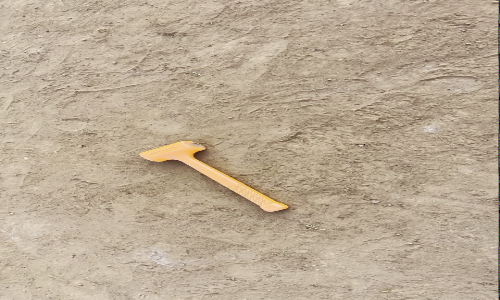

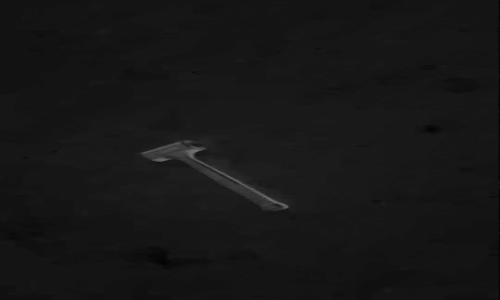

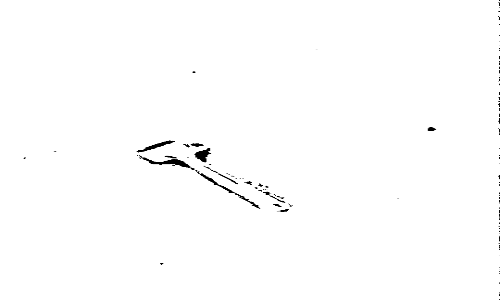

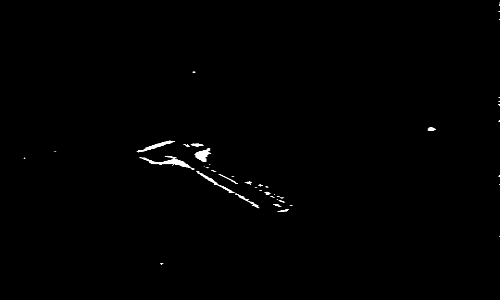

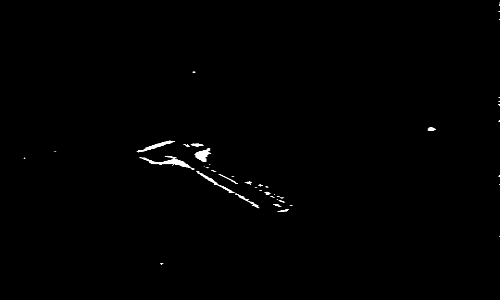

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 0.33 seconds


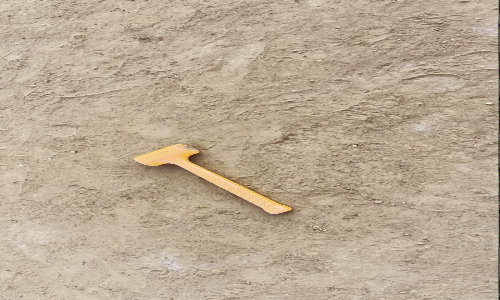

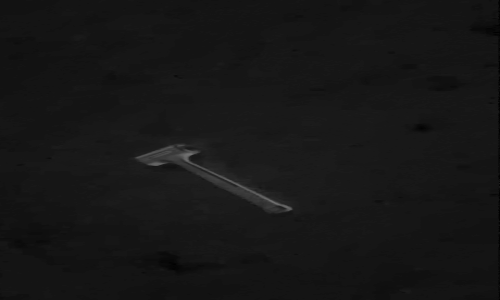

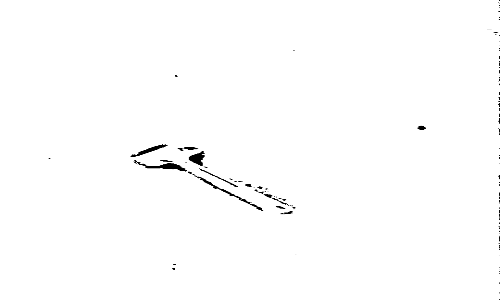

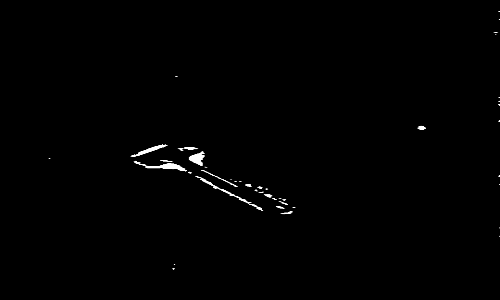

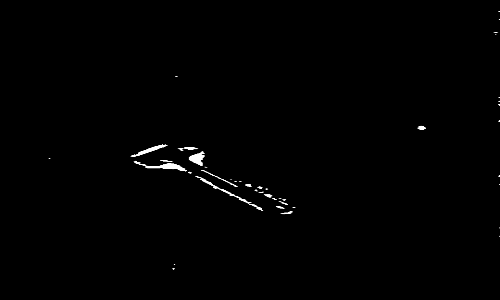

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 0.66 seconds


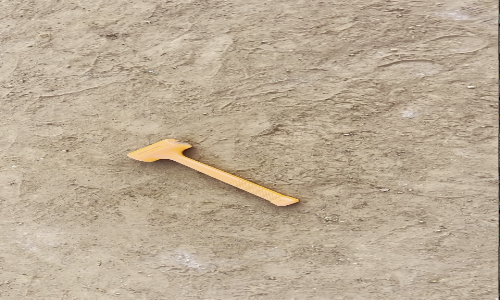

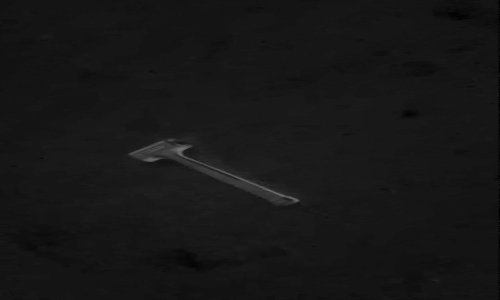

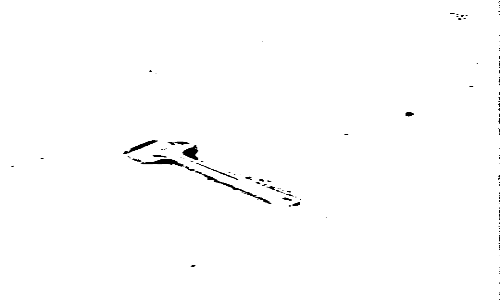

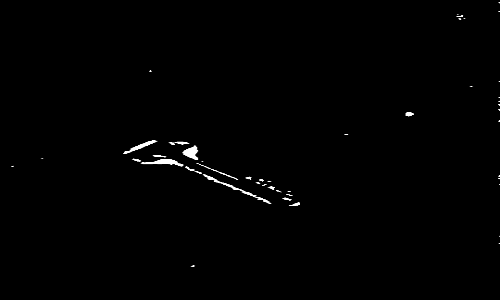

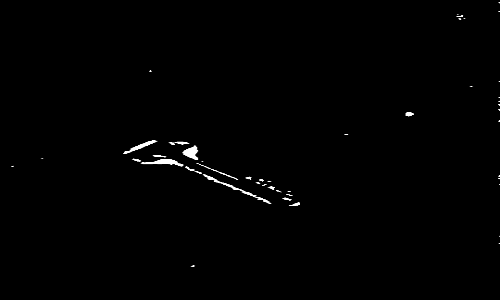

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 0.99 seconds


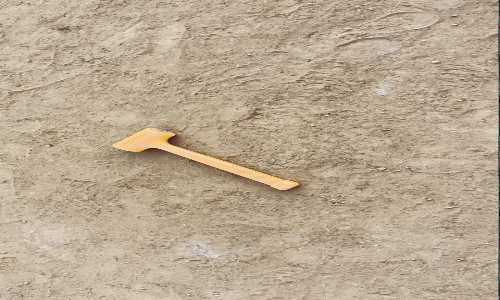

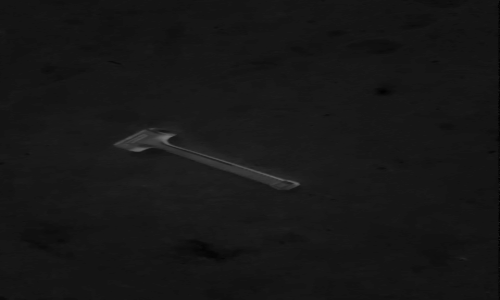

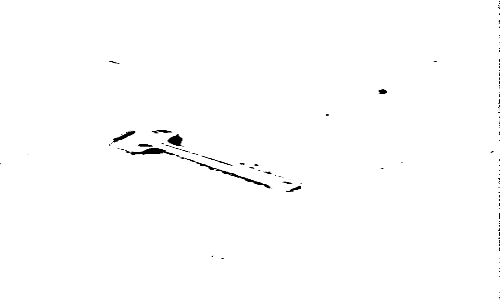

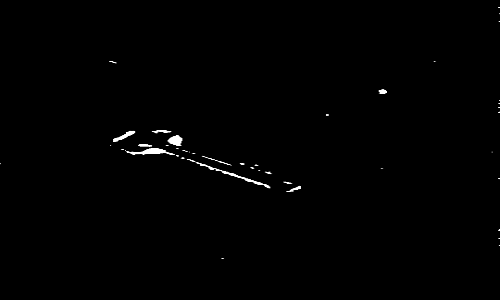

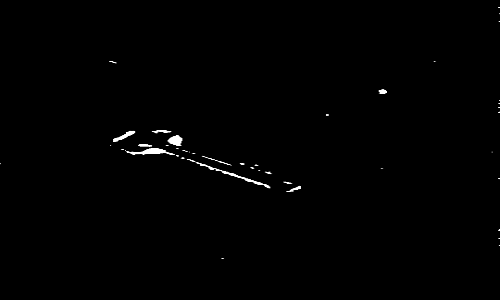

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 1.32 seconds


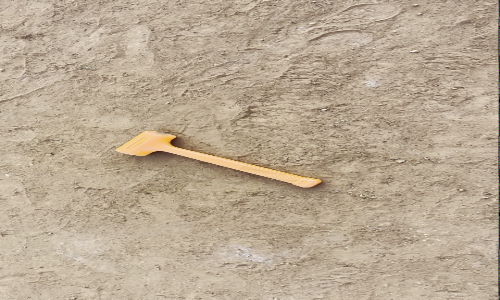

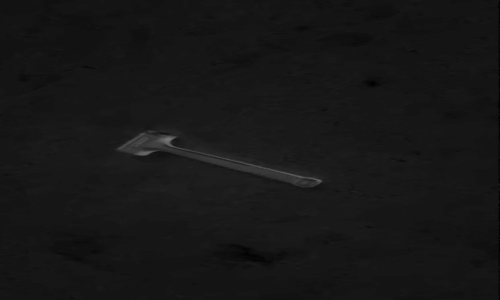

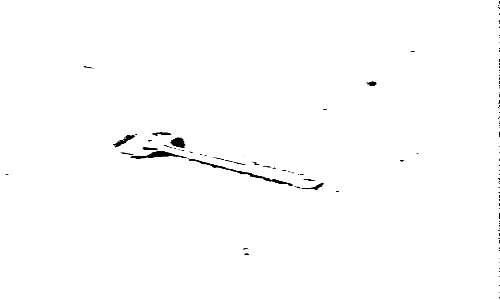

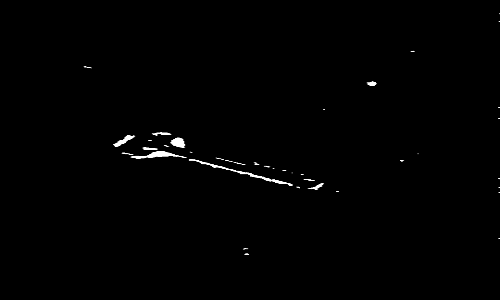

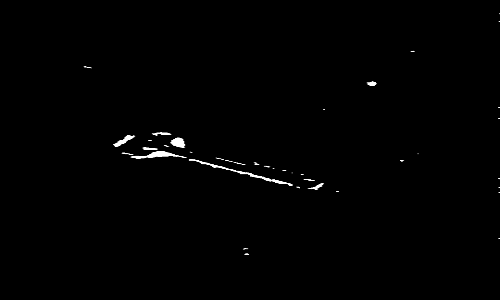

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 1.6500000000000001 seconds


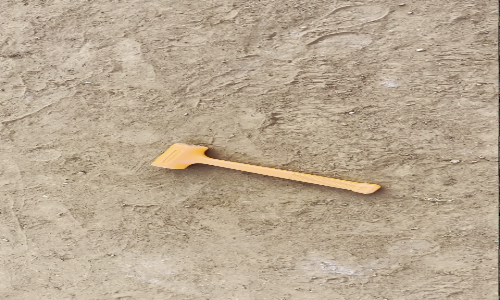

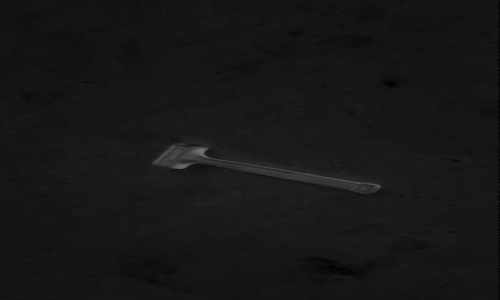

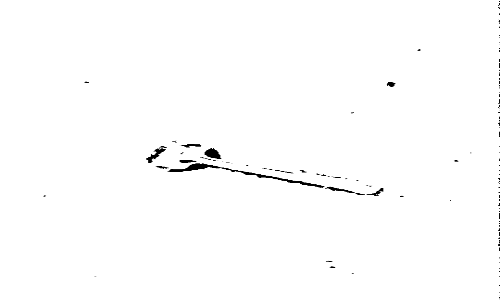

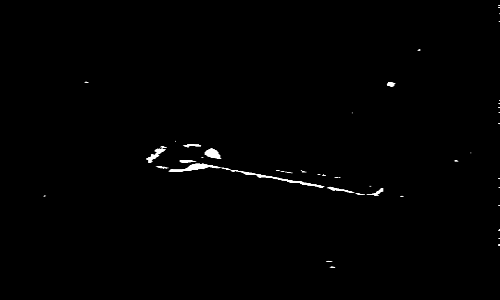

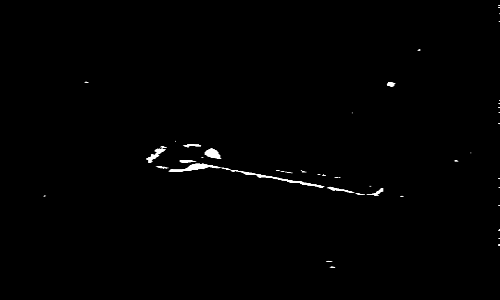

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 1.9800000000000002 seconds


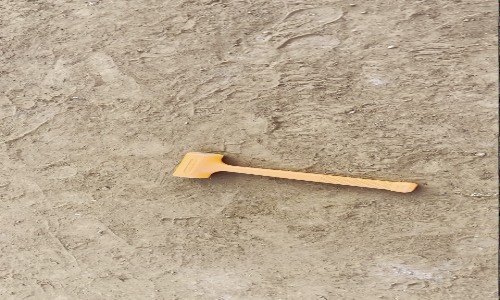

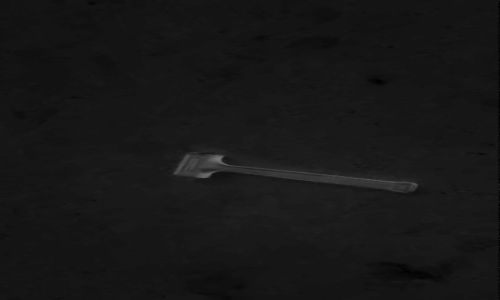

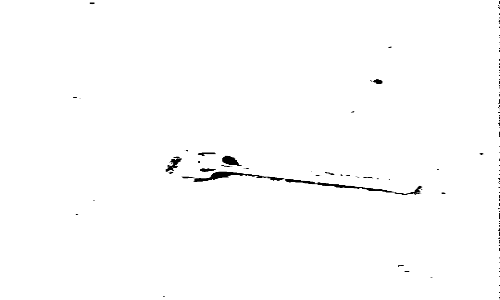

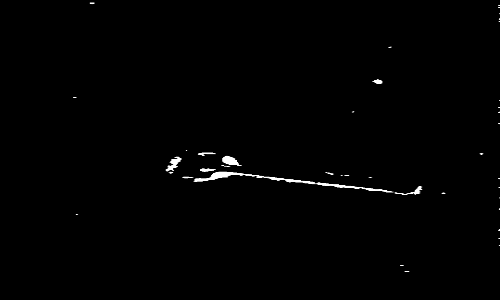

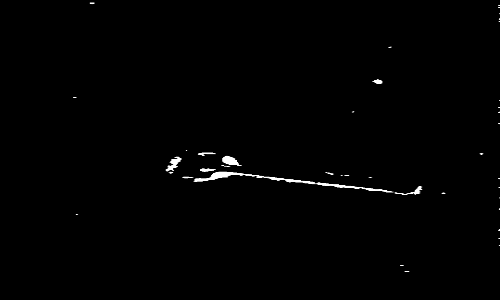

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 2.31 seconds


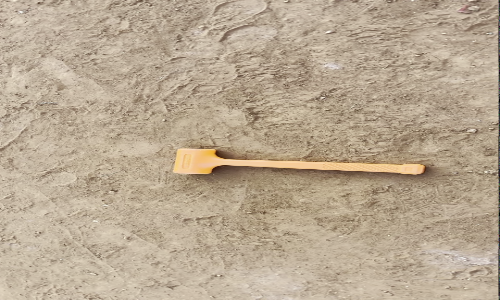

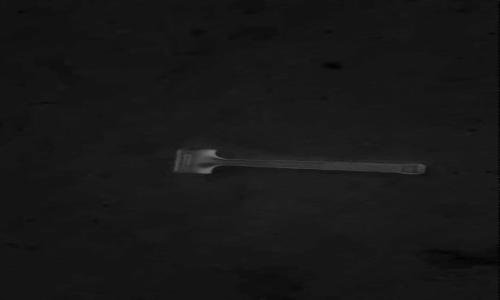

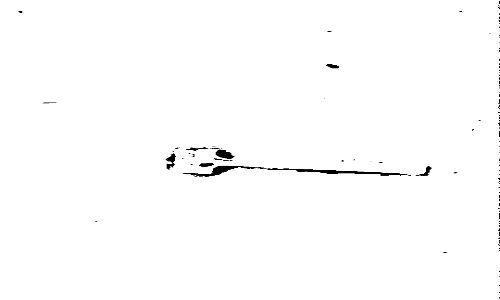

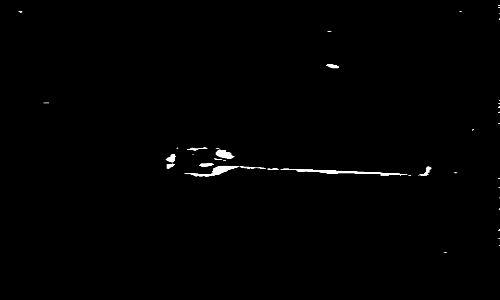

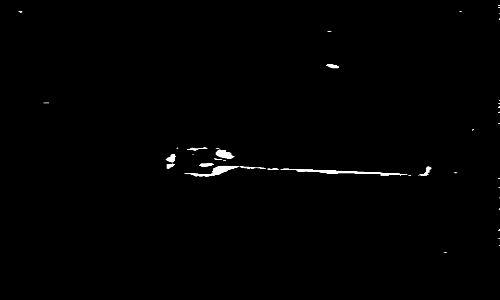

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 2.64 seconds


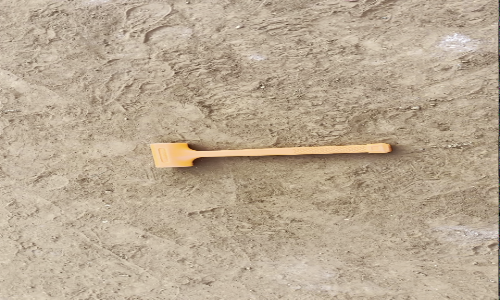

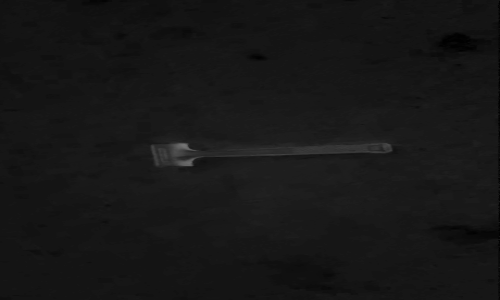

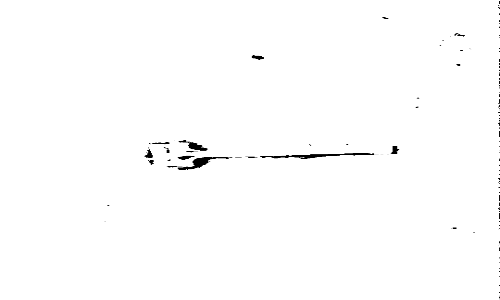

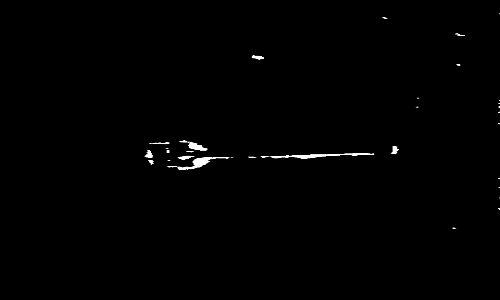

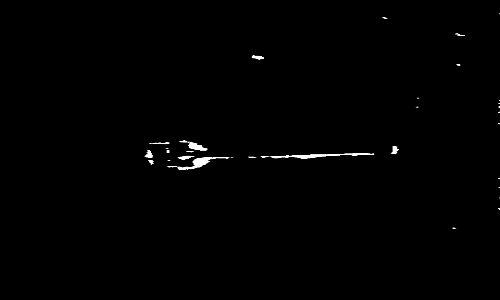

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 2.97 seconds


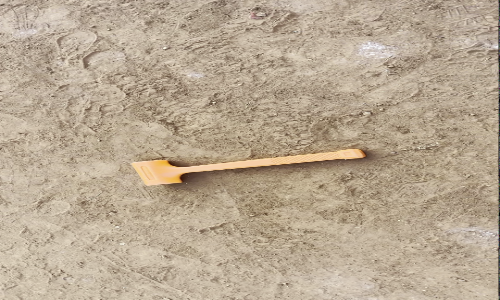

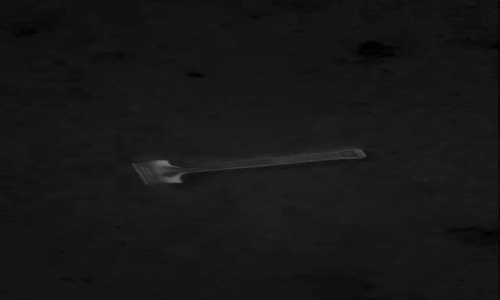

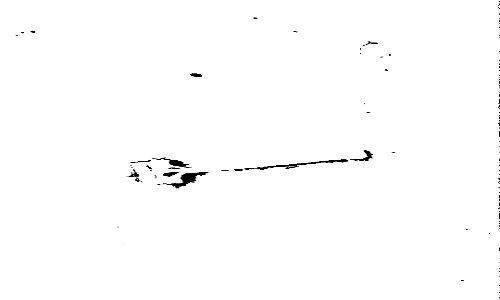

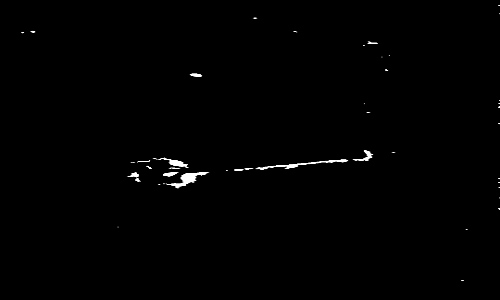

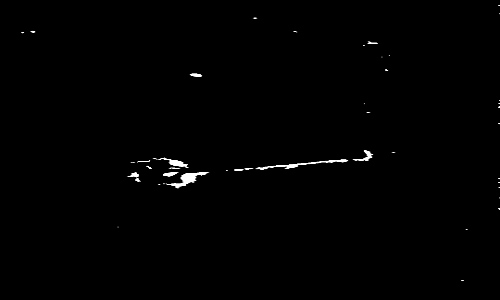

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 3.3000000000000003 seconds


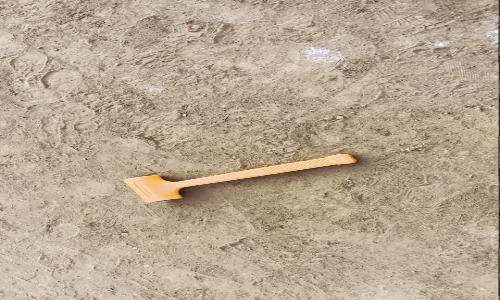

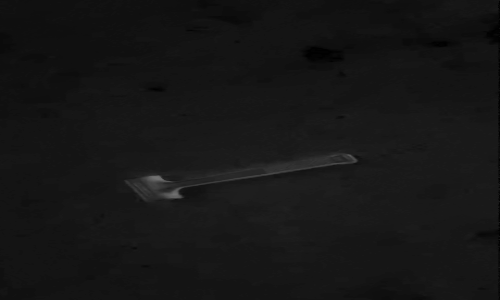

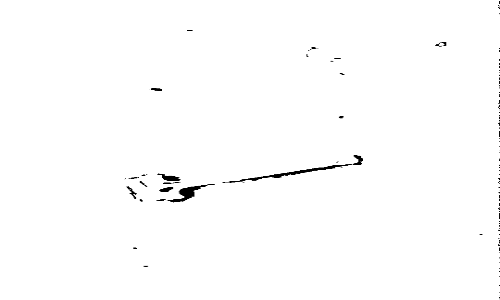

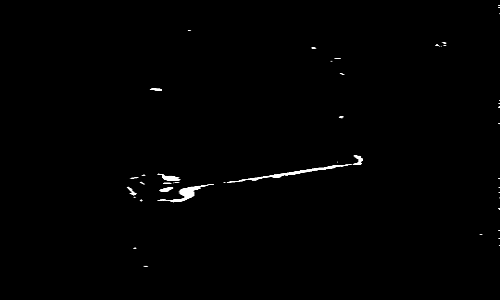

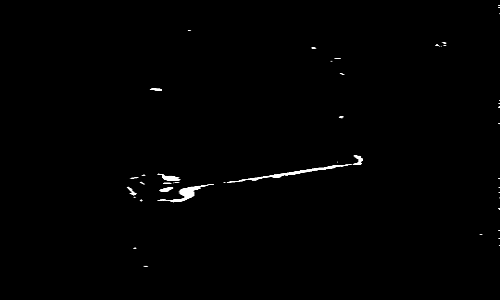

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 3.6300000000000003 seconds


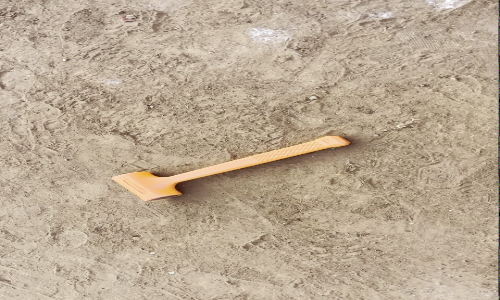

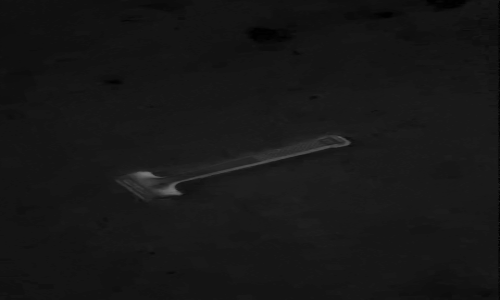

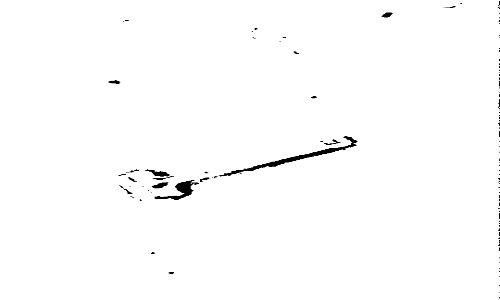

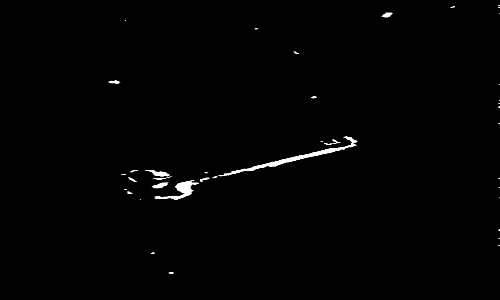

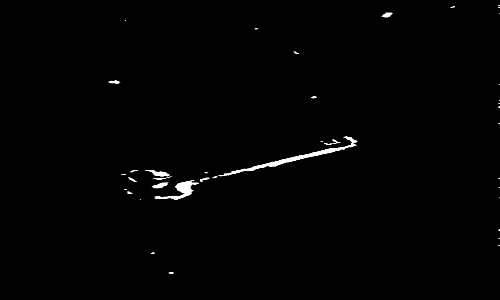

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 3.9600000000000004 seconds


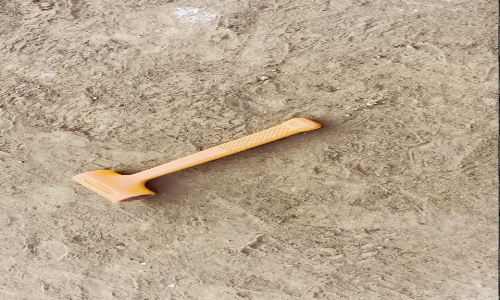

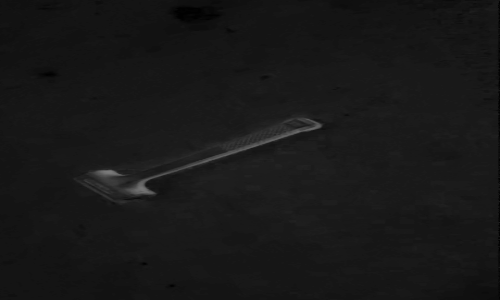

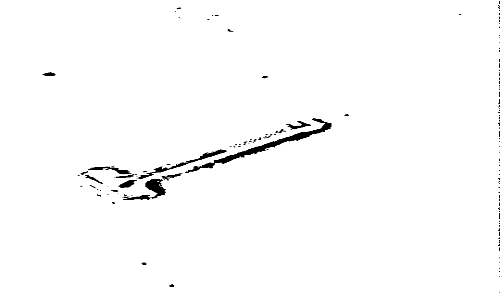

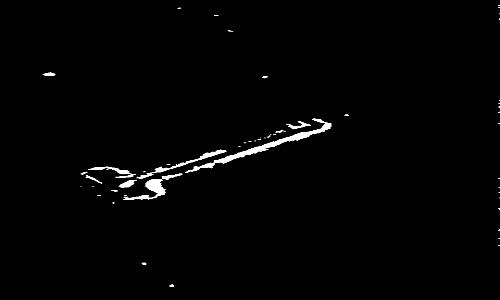

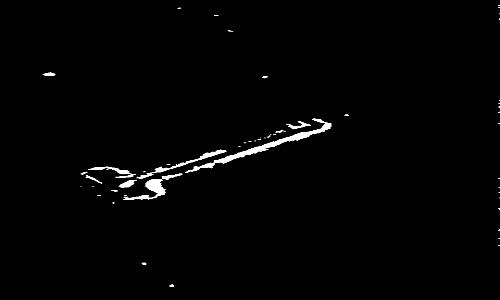

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 4.29 seconds


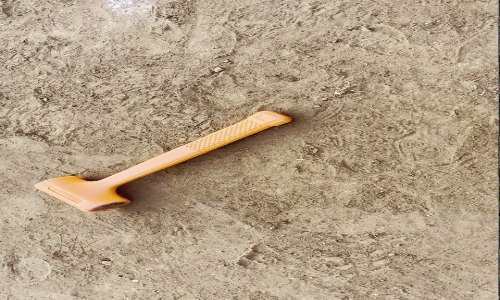

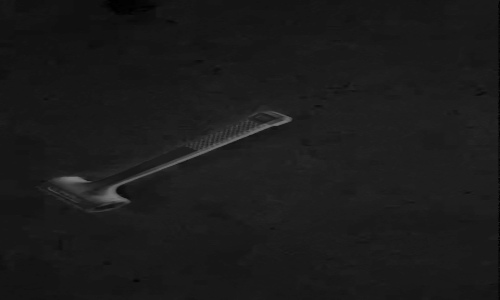

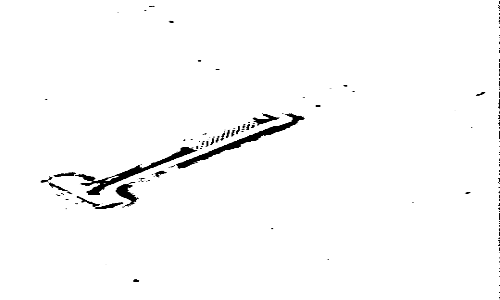

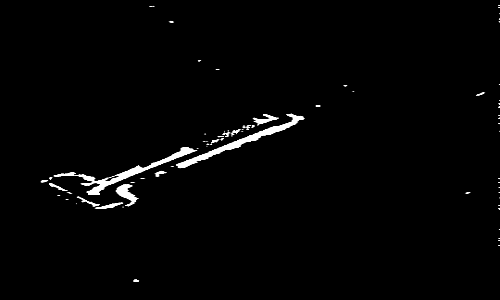

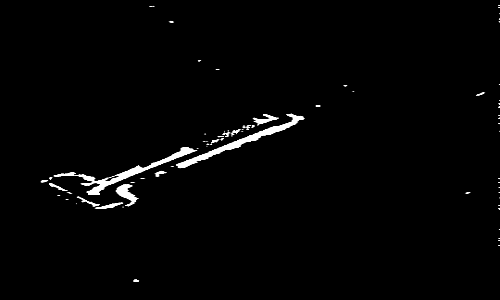

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 4.62 seconds


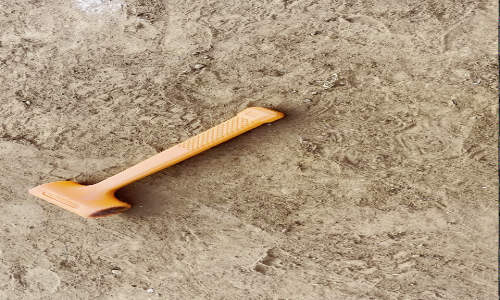

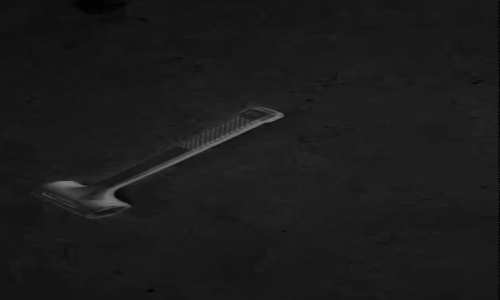

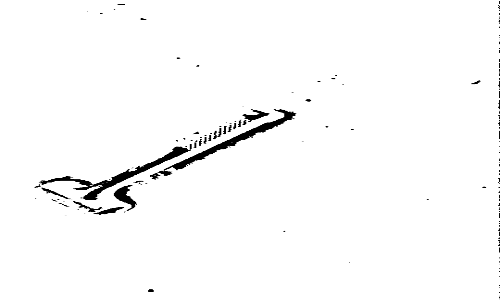

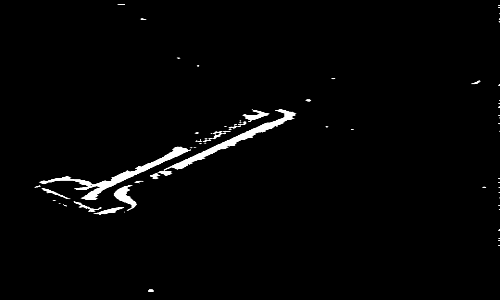

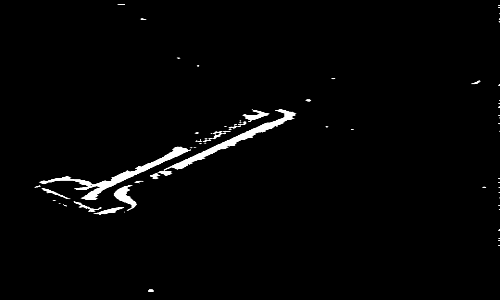

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 4.95 seconds


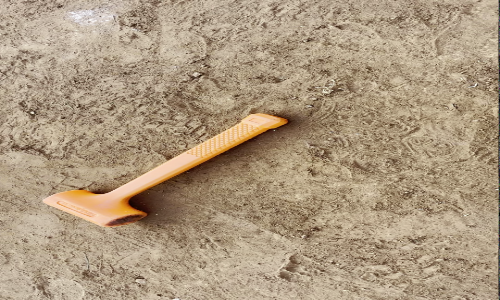

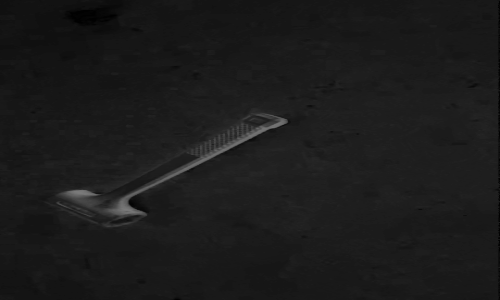

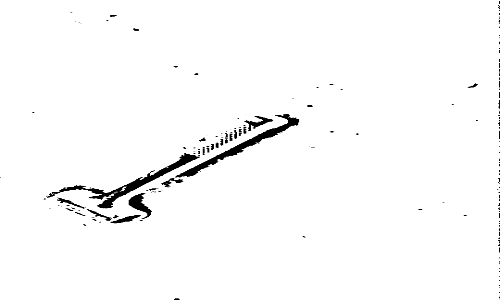

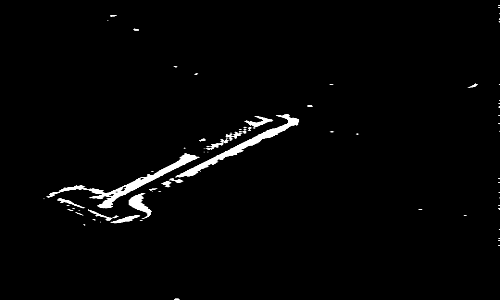

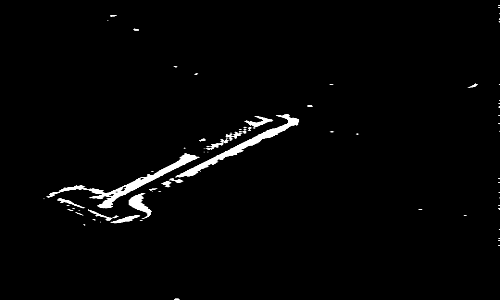

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 5.28 seconds


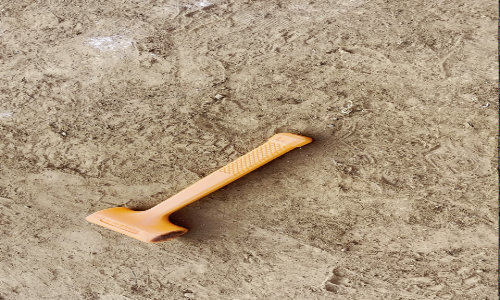

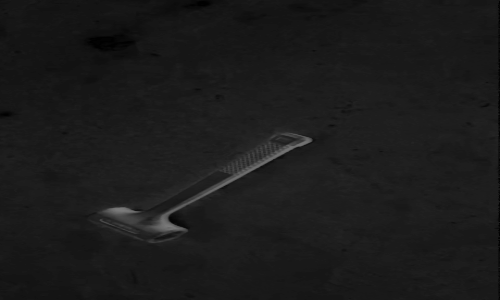

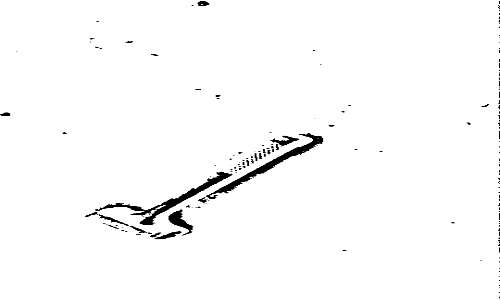

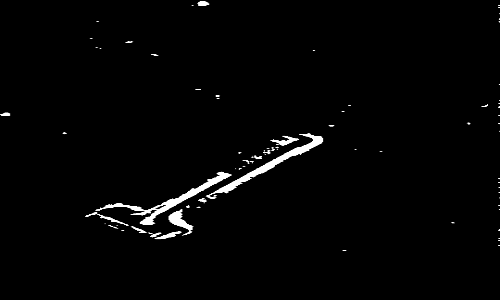

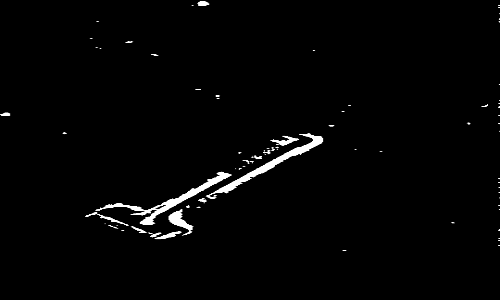

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 5.61 seconds


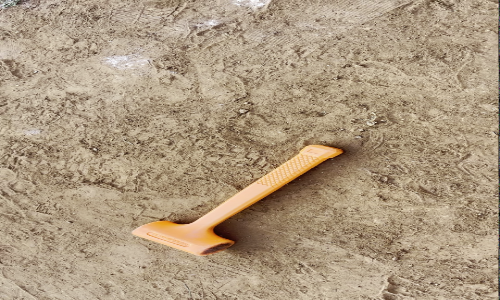

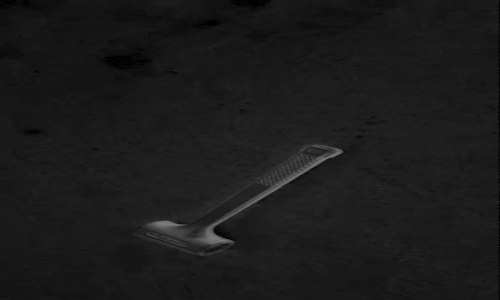

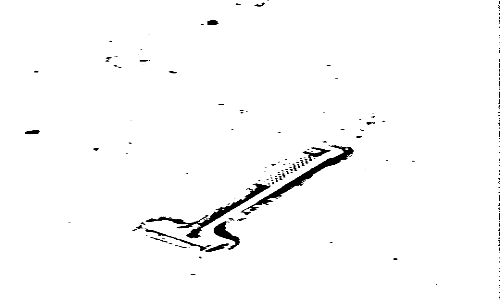

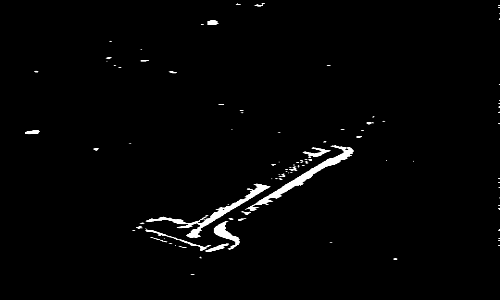

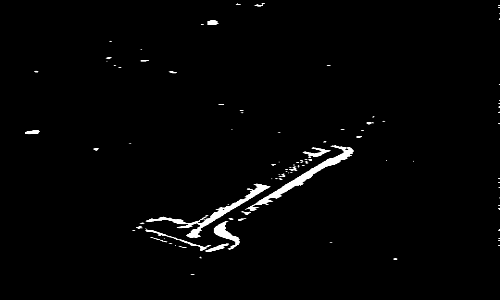

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 5.94 seconds


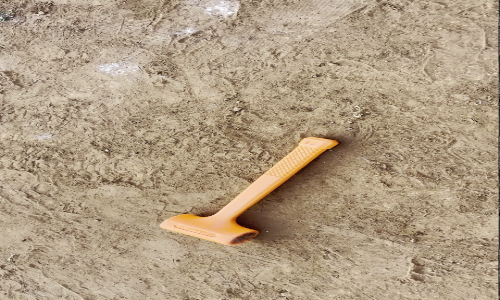

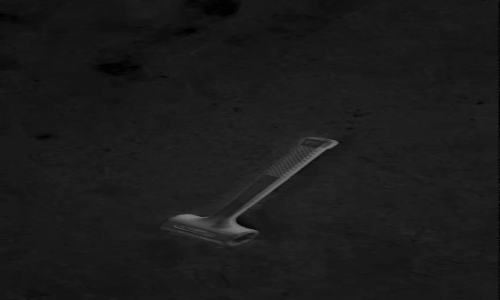

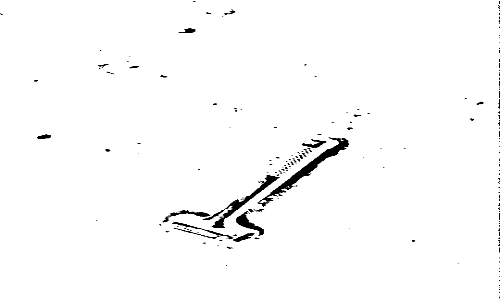

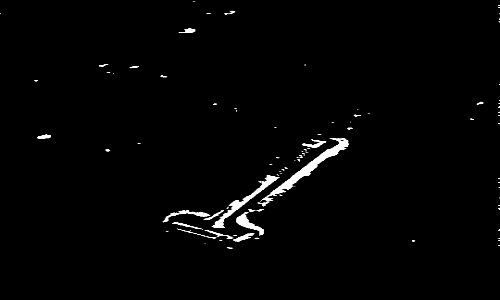

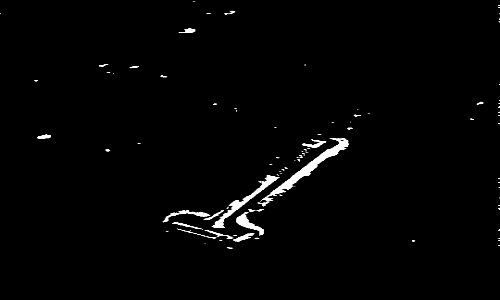

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 6.2700000000000005 seconds


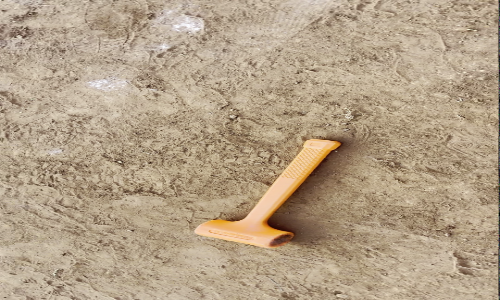

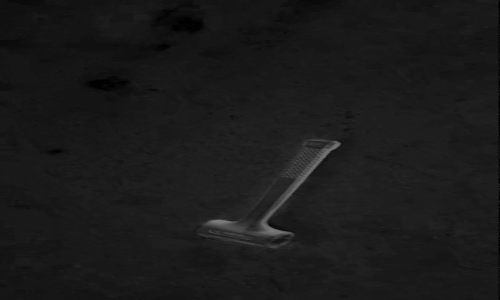

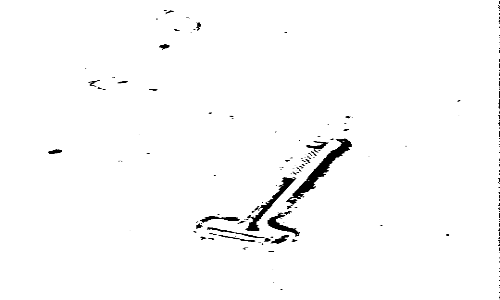

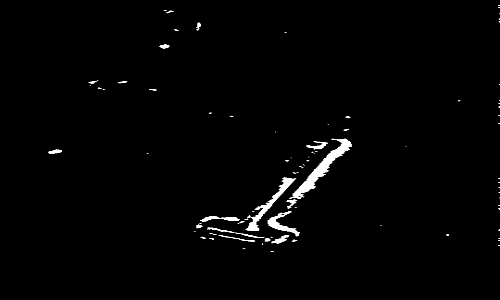

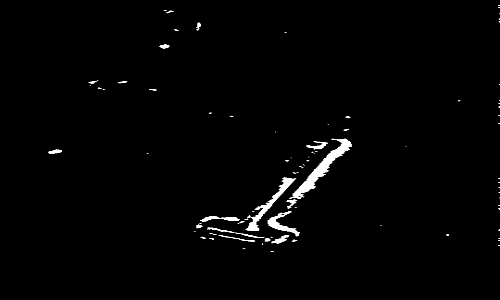

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 6.6000000000000005 seconds


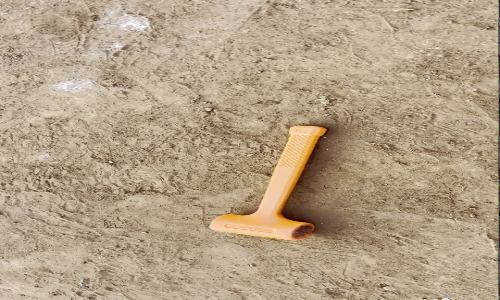

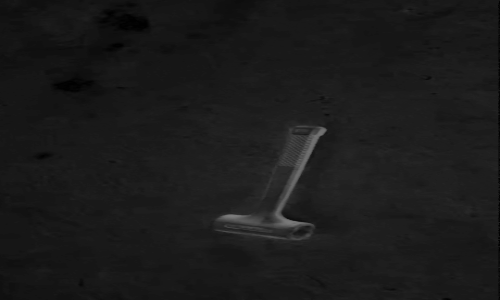

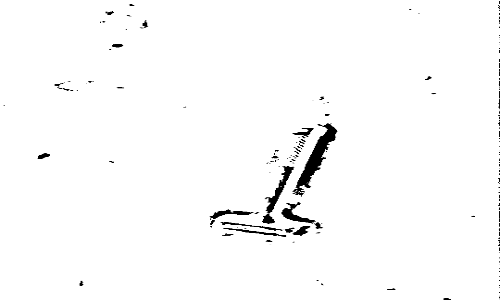

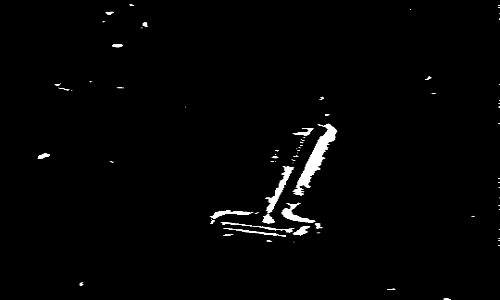

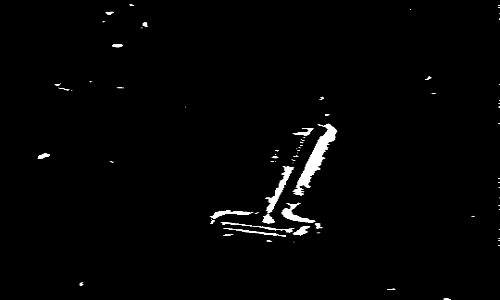

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 6.930000000000001 seconds


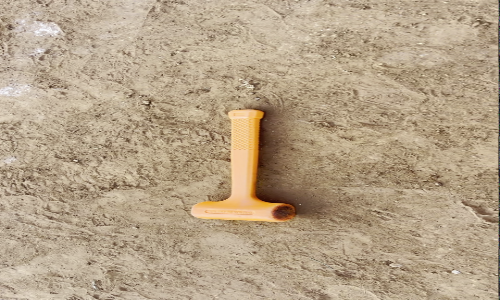

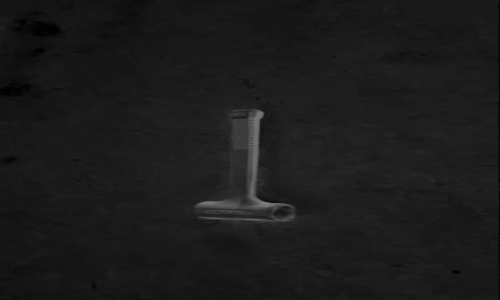

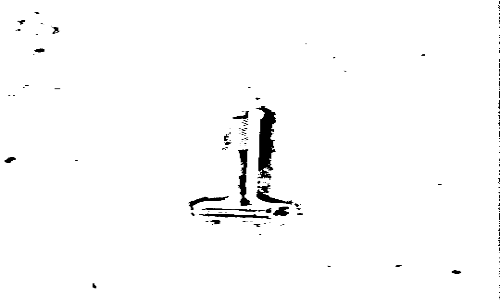

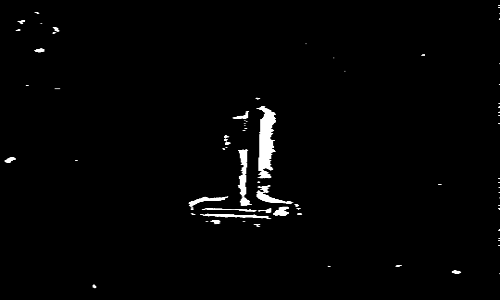

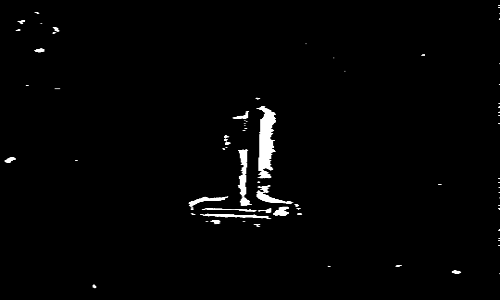

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 7.260000000000001 seconds


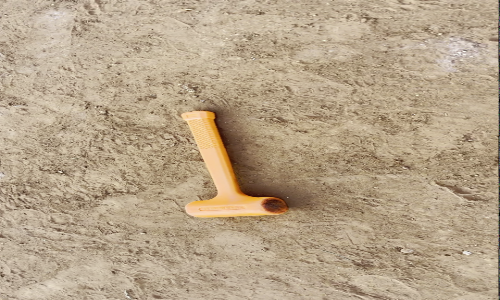

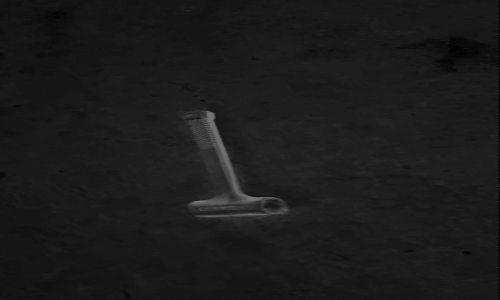

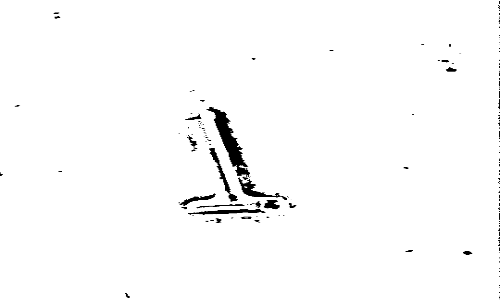

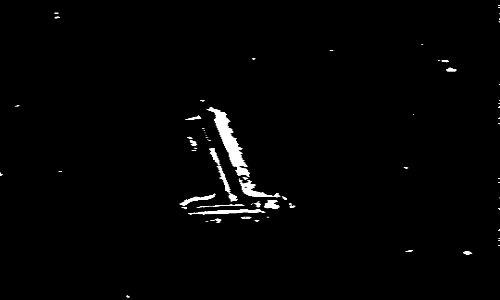

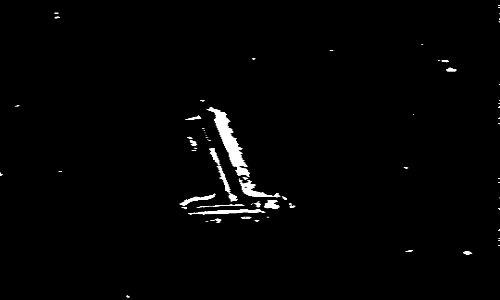

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 7.590000000000001 seconds


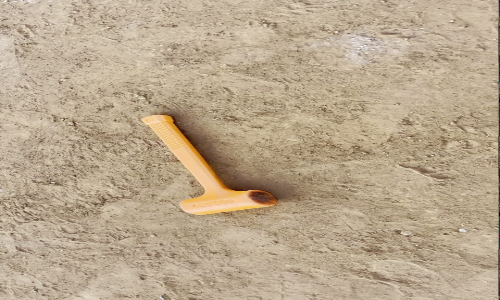

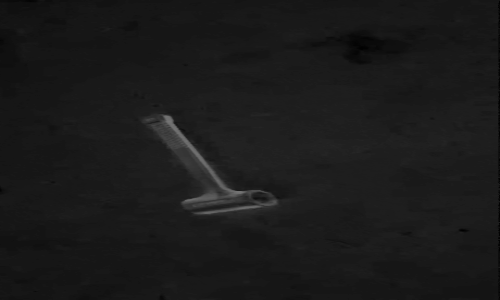

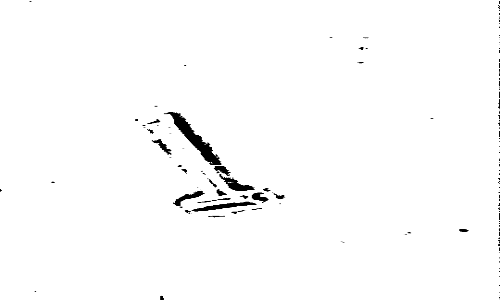

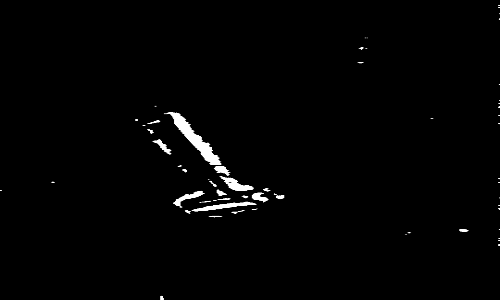

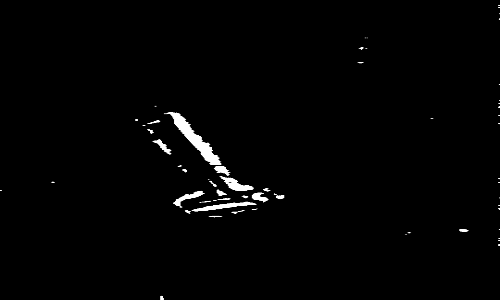

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 7.920000000000001 seconds


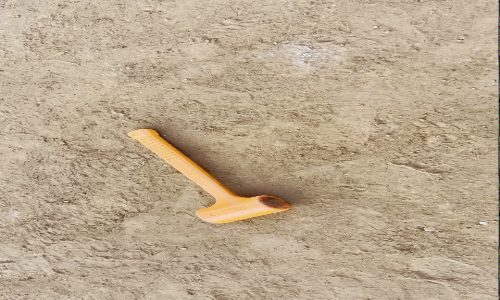

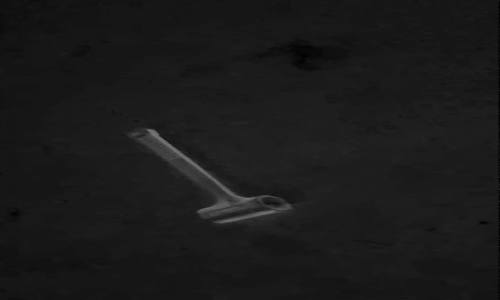

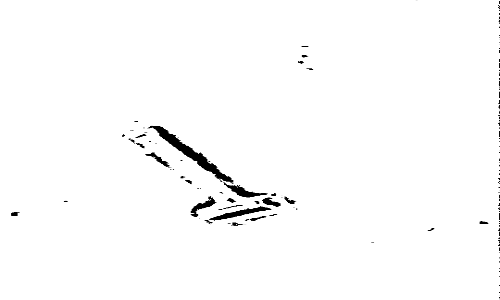

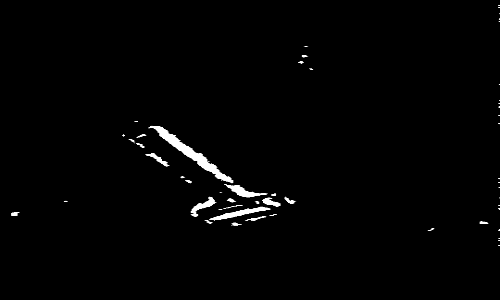

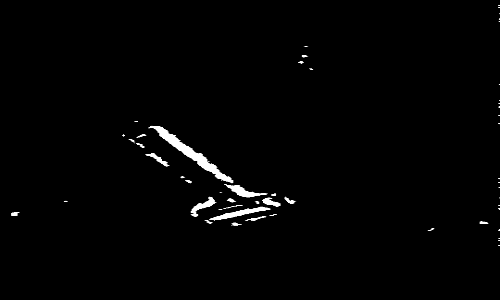

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 8.25 seconds


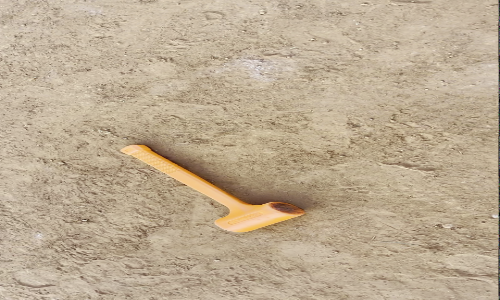

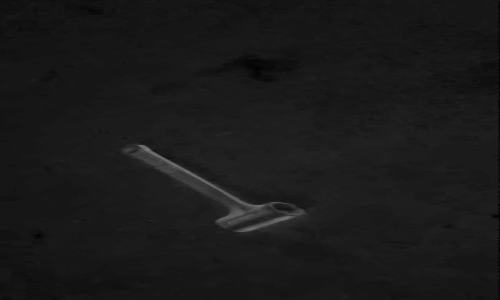

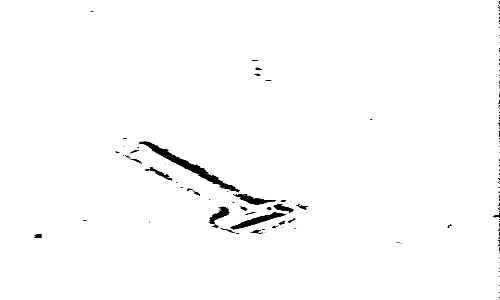

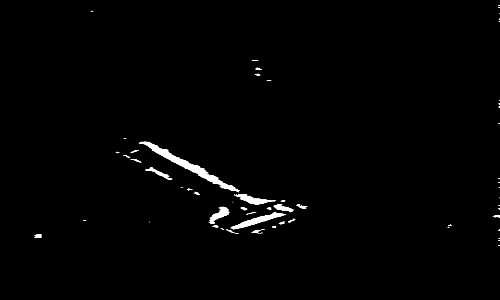

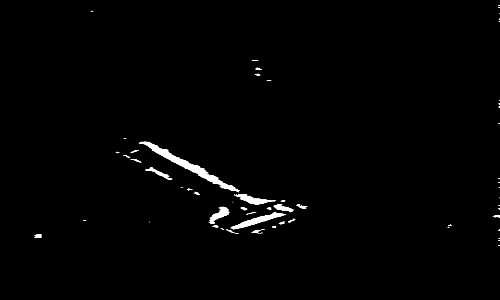

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 8.58 seconds


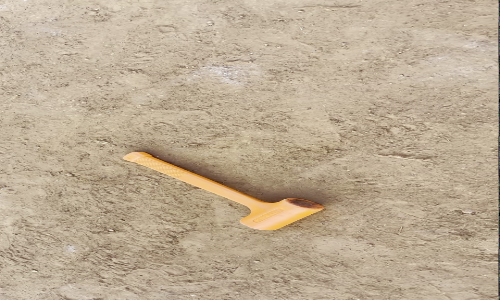

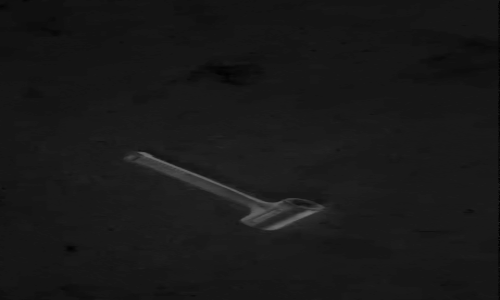

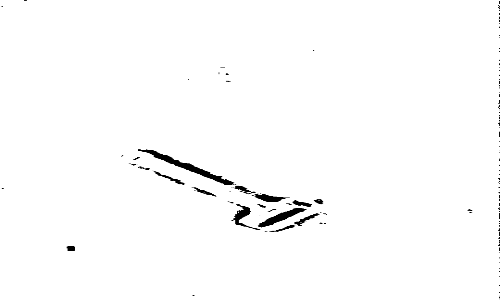

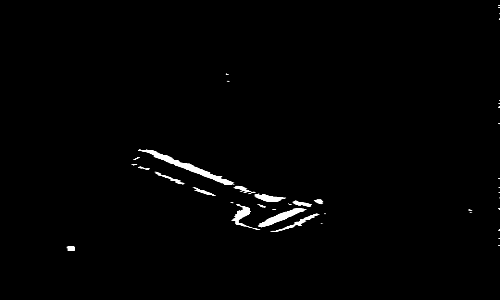

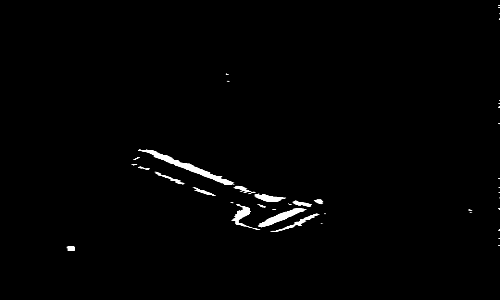

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 8.91 seconds


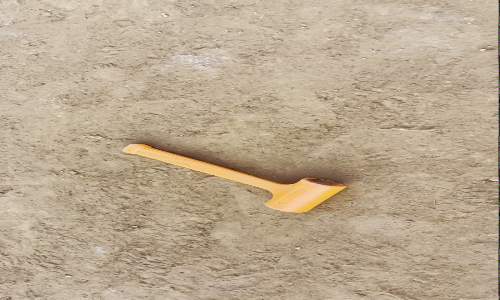

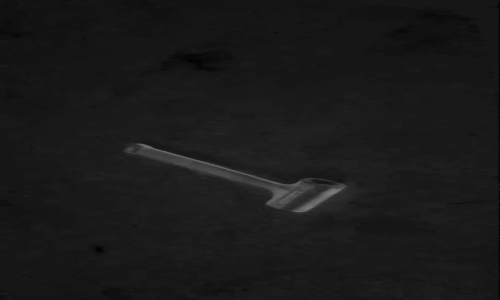

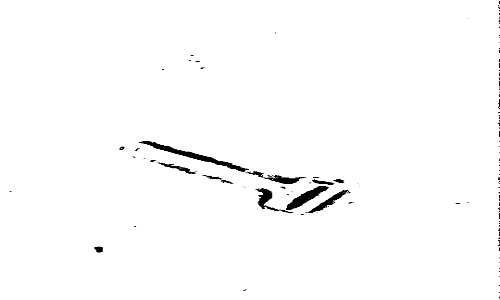

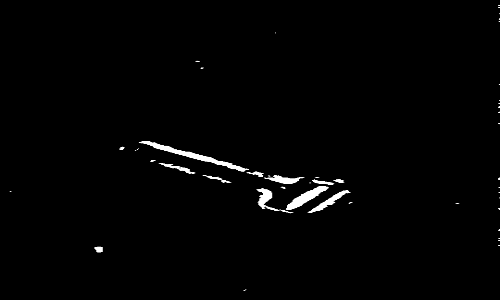

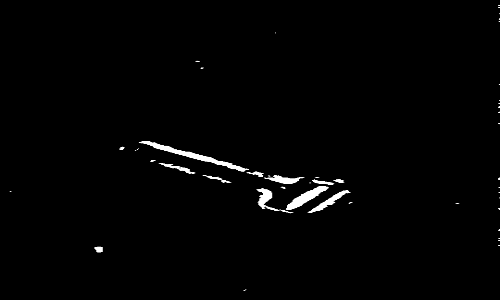

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 9.24 seconds


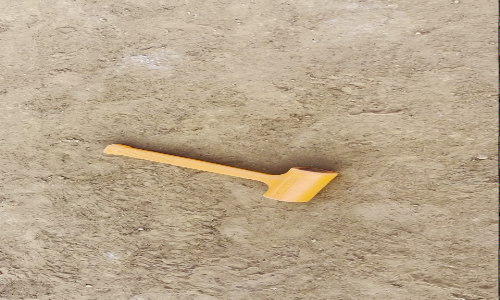

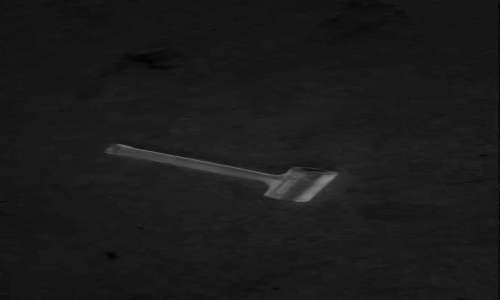

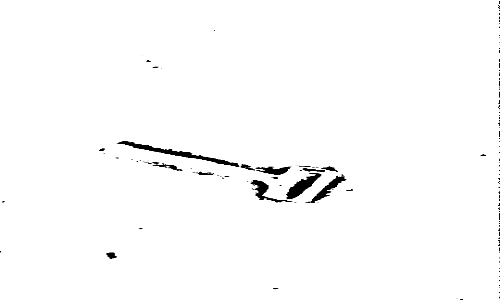

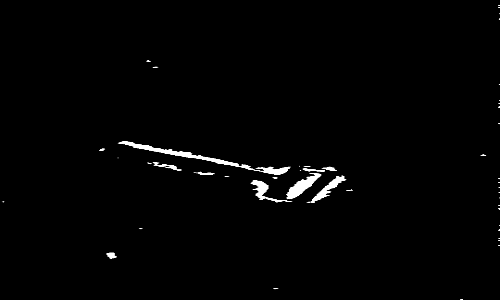

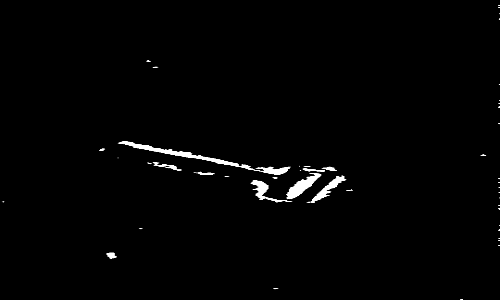

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 9.57 seconds


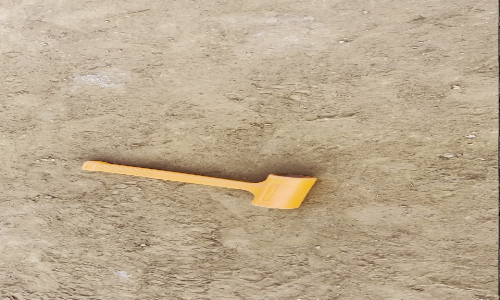

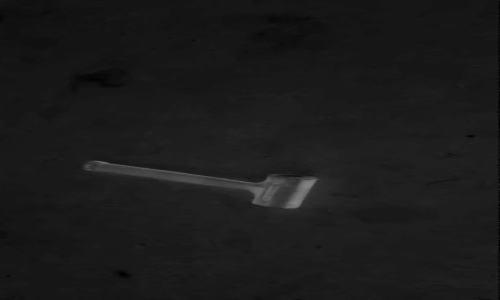

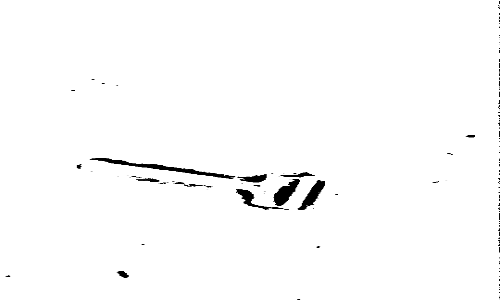

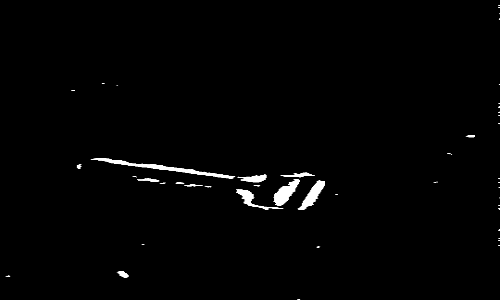

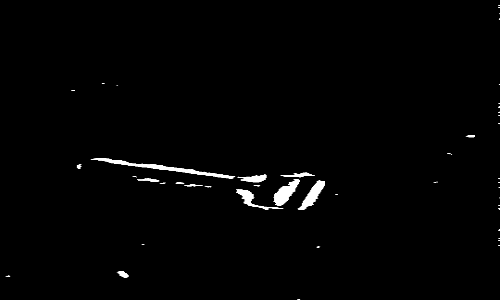

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 9.9 seconds


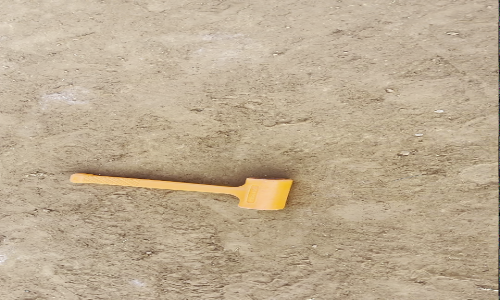

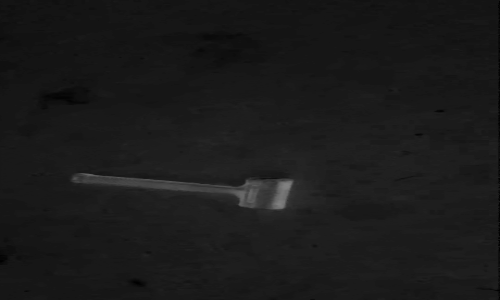

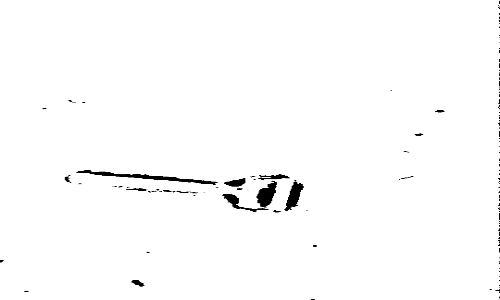

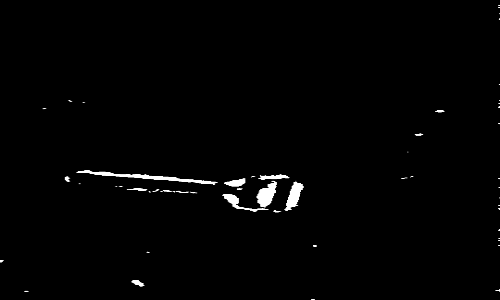

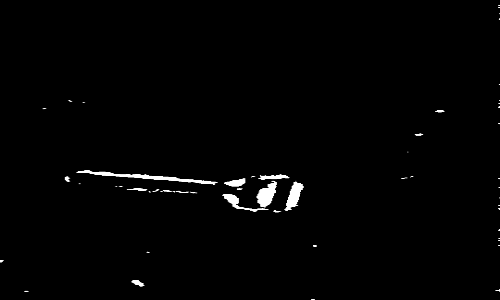

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 10.23 seconds


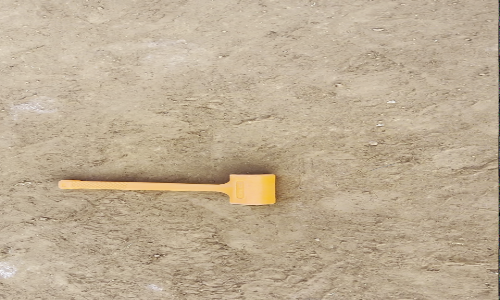

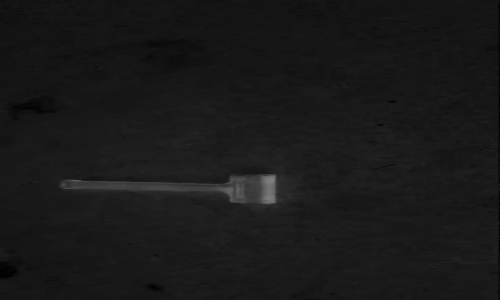

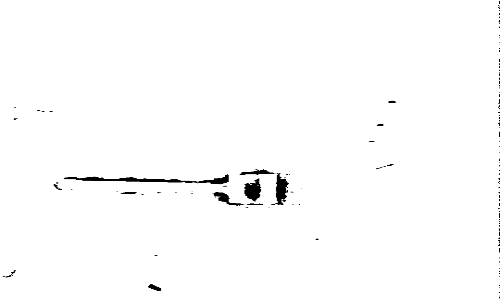

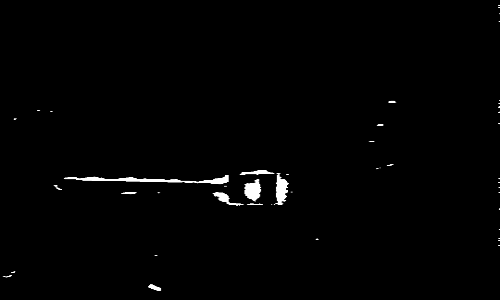

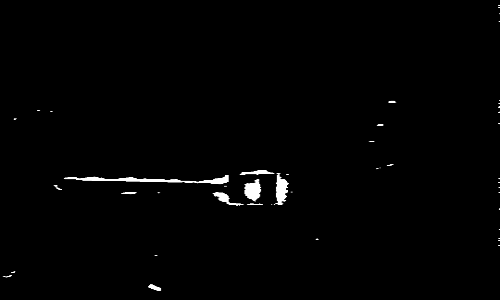

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 10.56 seconds


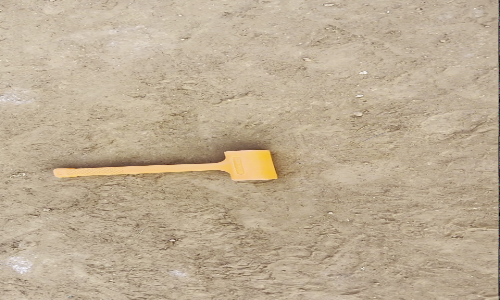

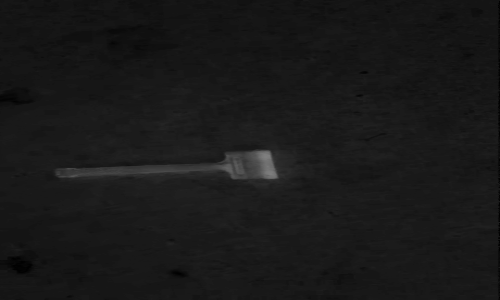

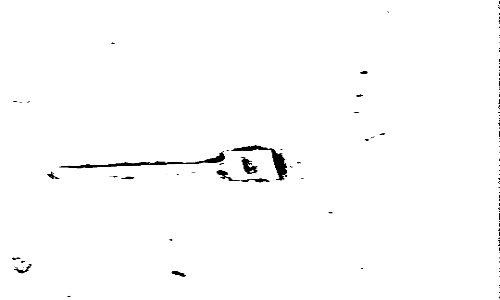

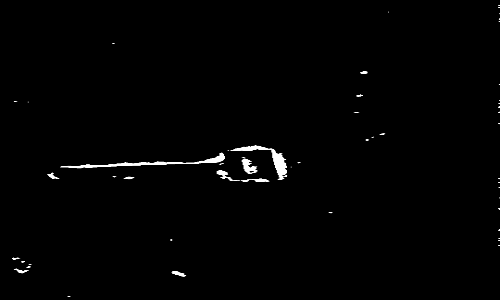

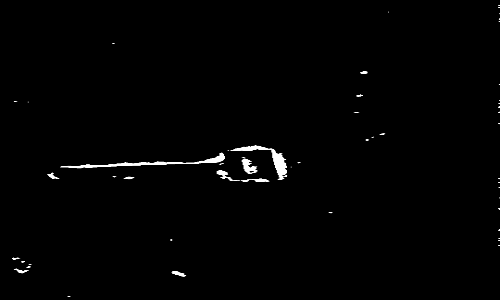

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 10.89 seconds


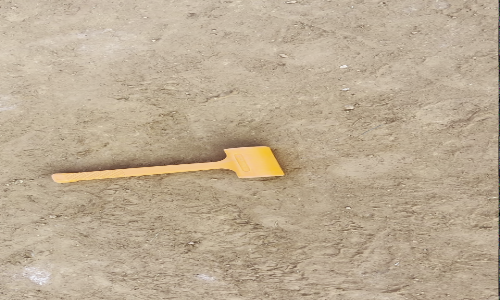

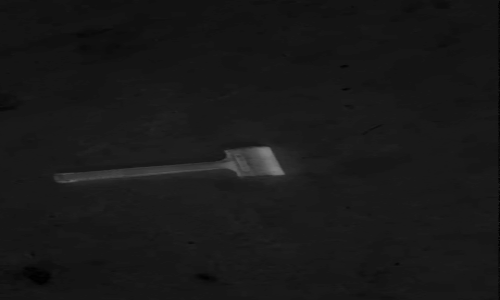

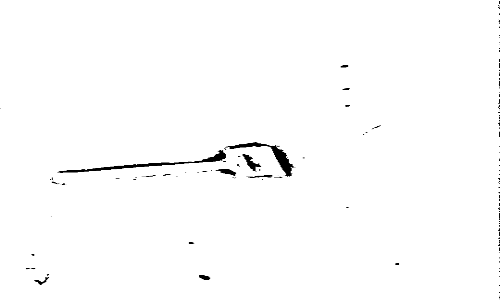

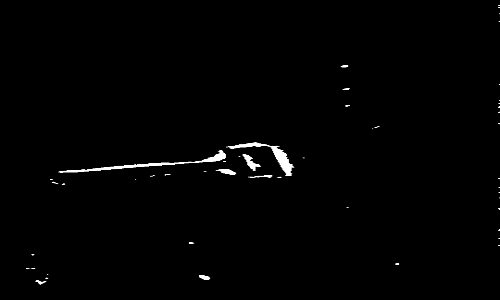

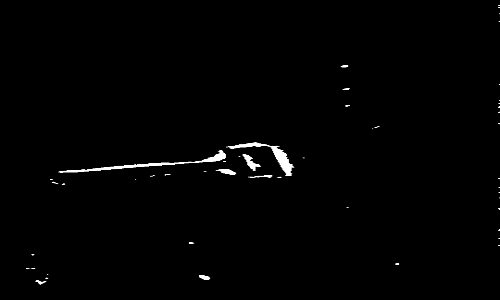

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 11.22 seconds


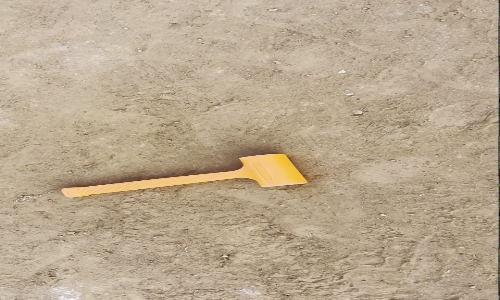

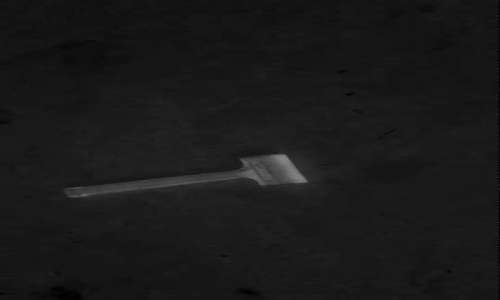

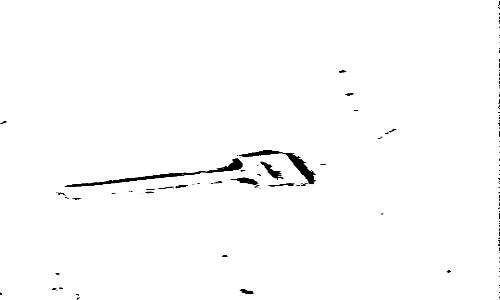

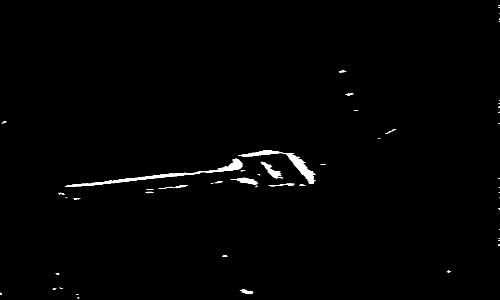

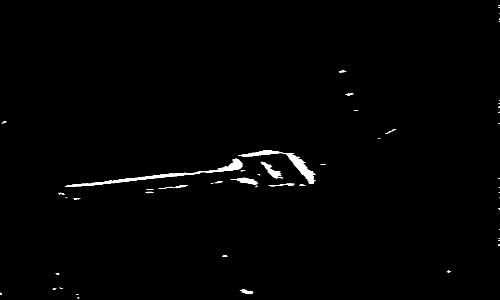

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 11.55 seconds


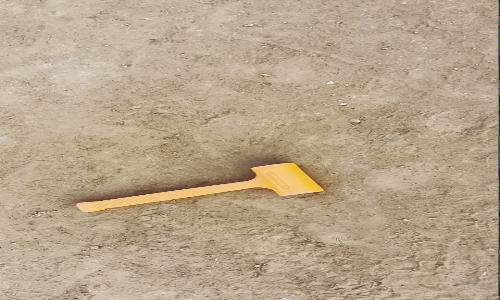

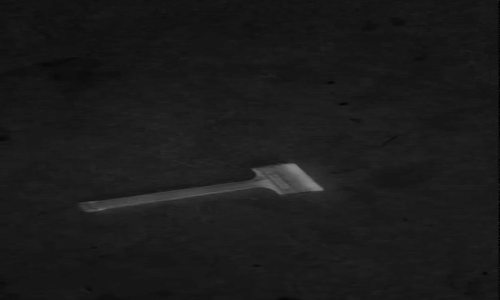

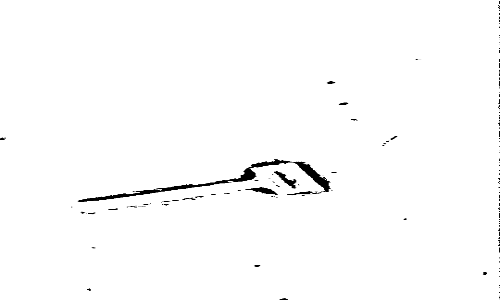

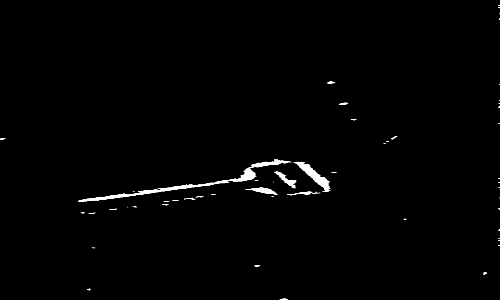

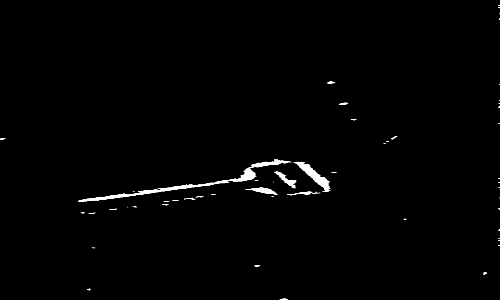

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 11.88 seconds


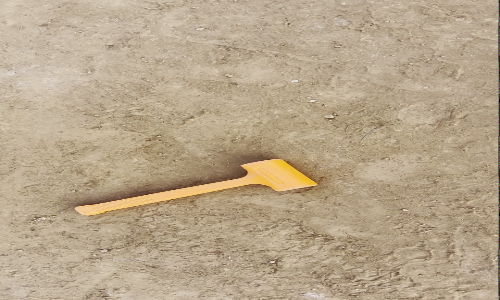

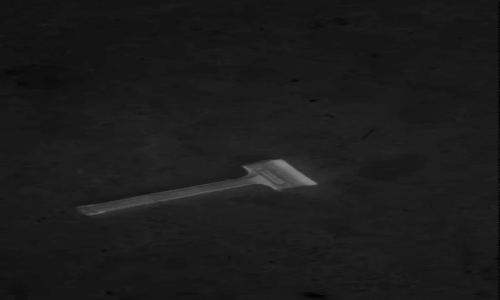

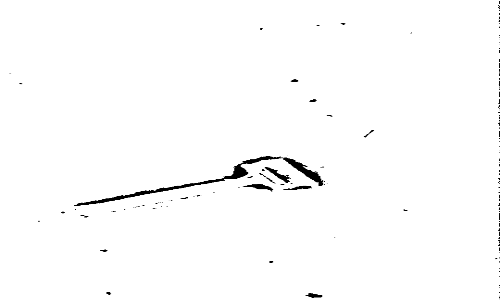

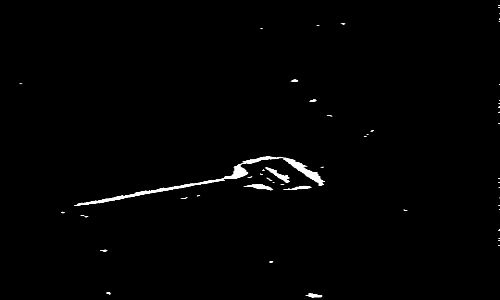

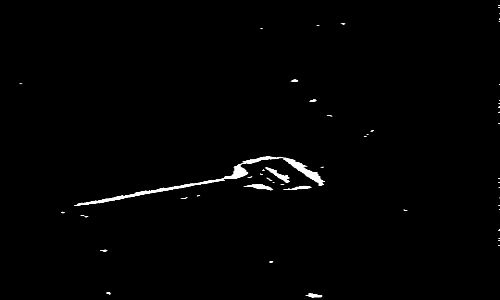

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 12.21 seconds


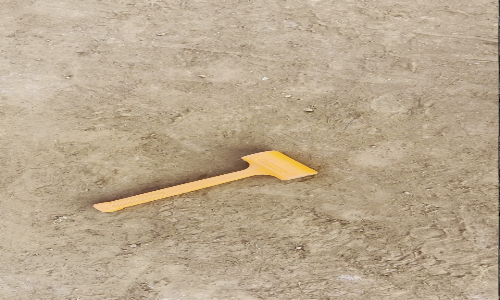

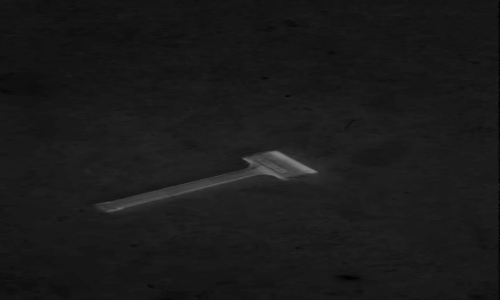

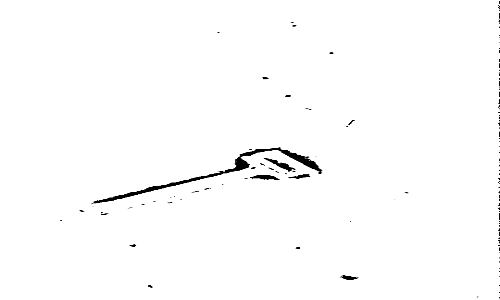

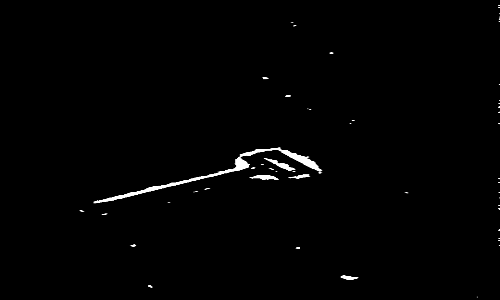

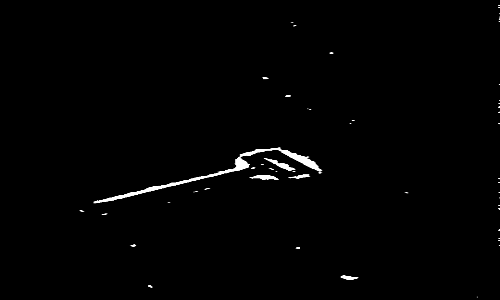

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 12.540000000000001 seconds


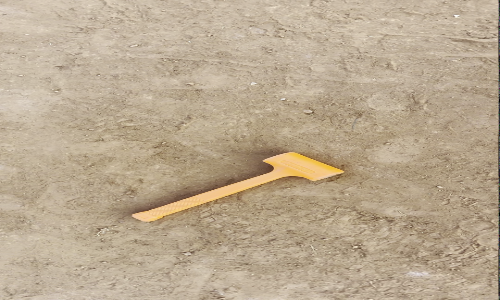

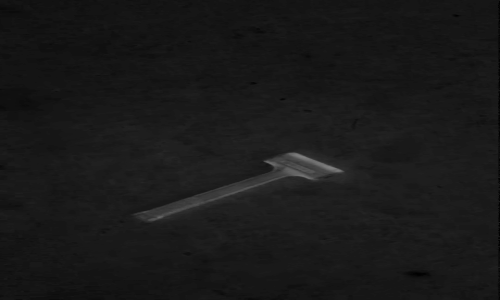

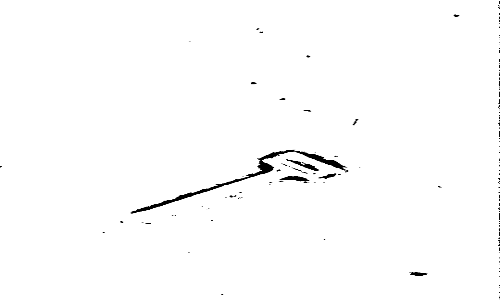

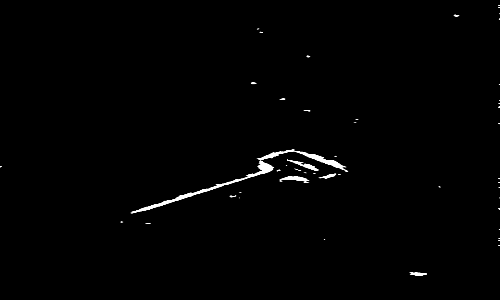

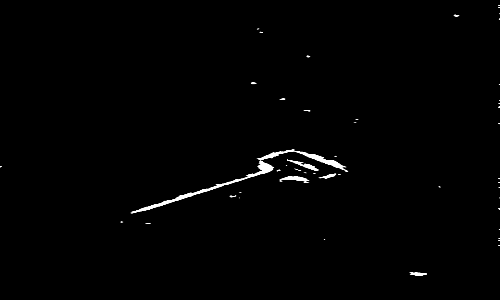

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 12.870000000000001 seconds


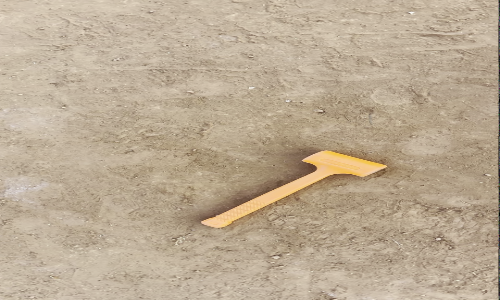

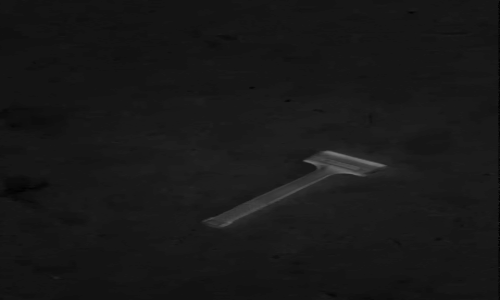

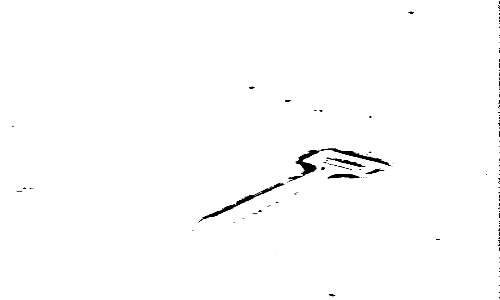

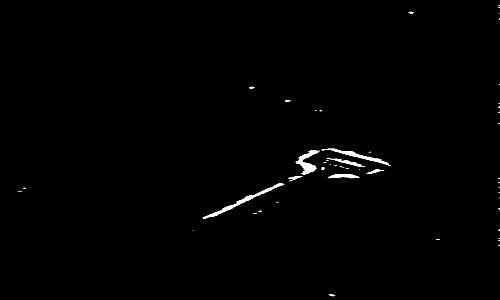

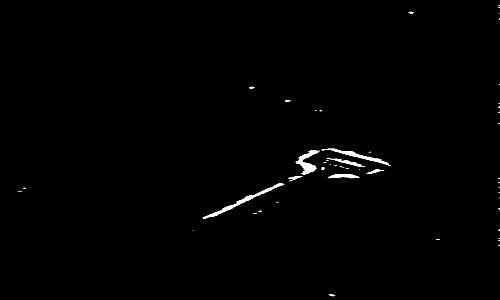

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 13.200000000000001 seconds


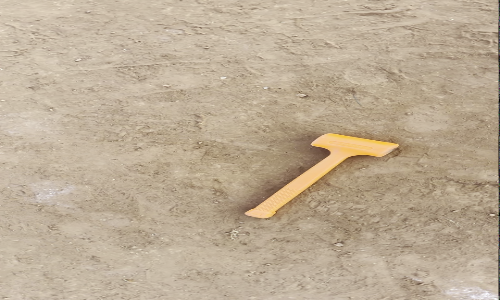

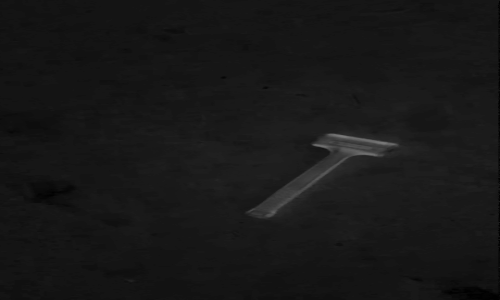

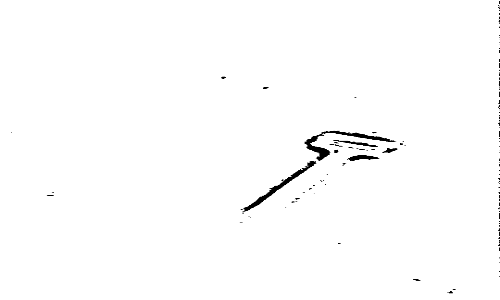

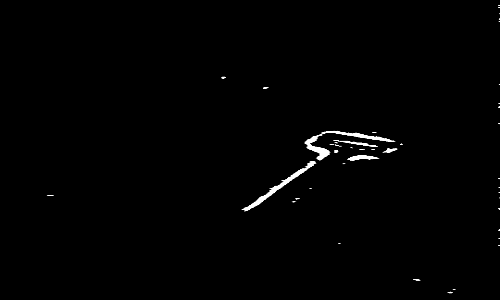

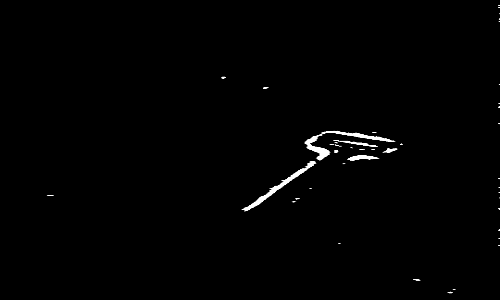

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 13.530000000000001 seconds


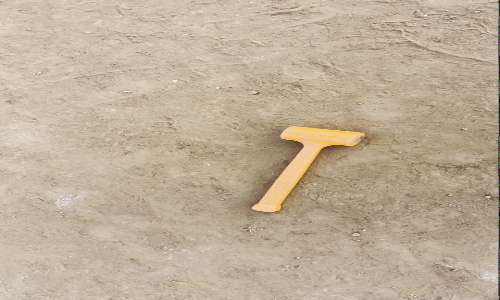

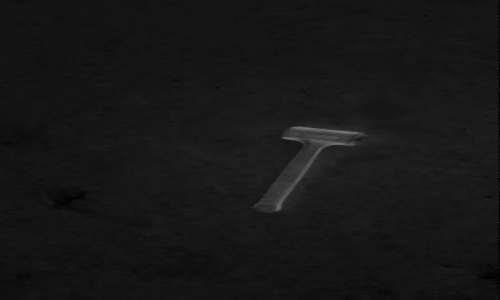

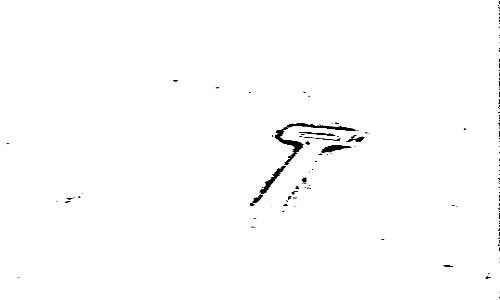

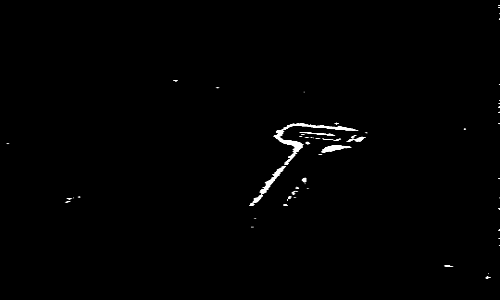

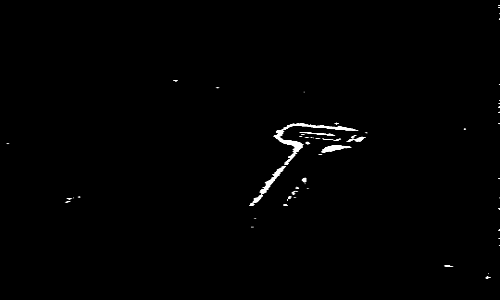

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 13.860000000000001 seconds


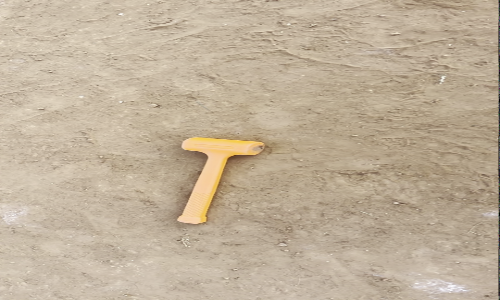

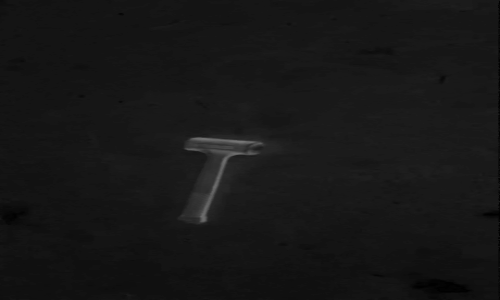

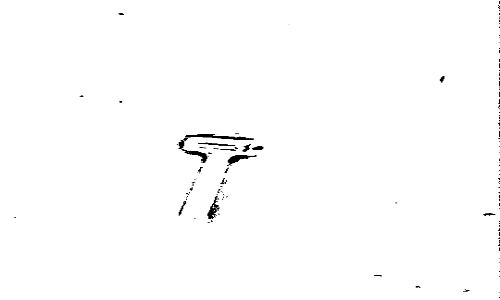

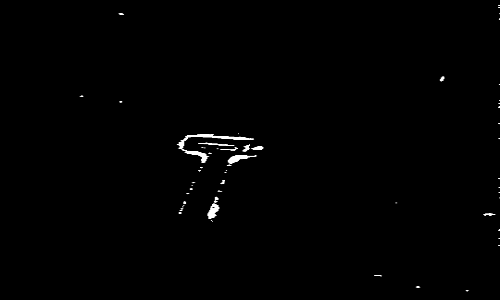

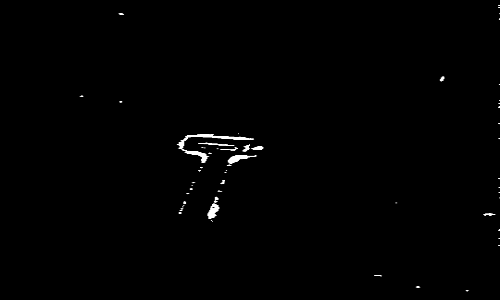

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 14.190000000000001 seconds


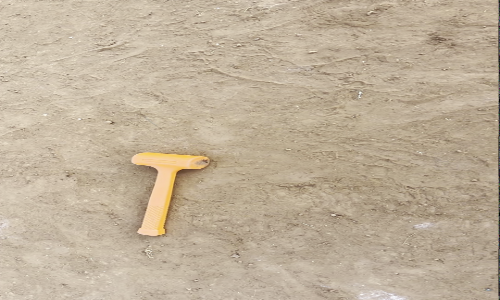

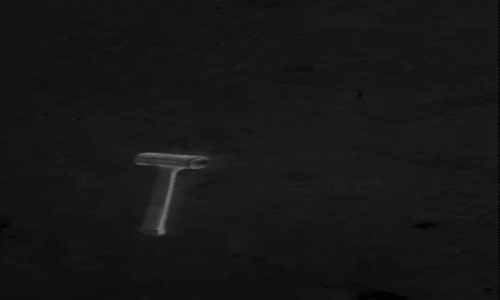

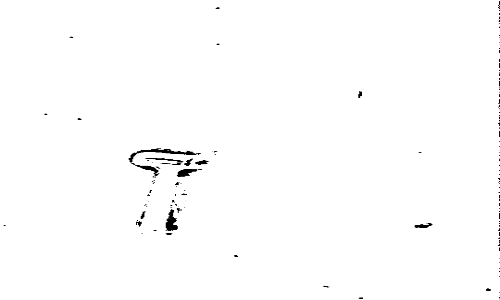

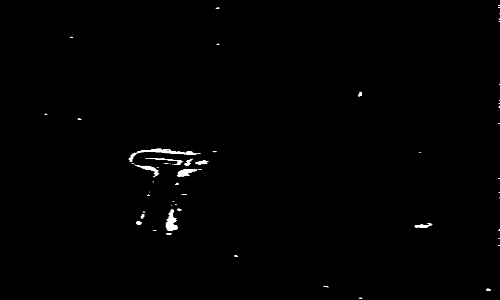

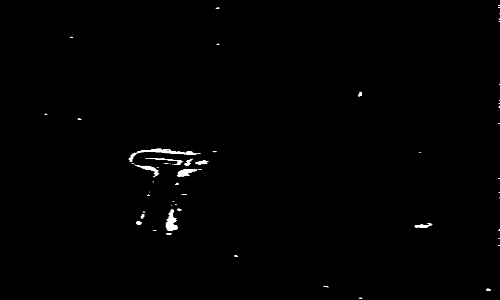

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 14.520000000000001 seconds


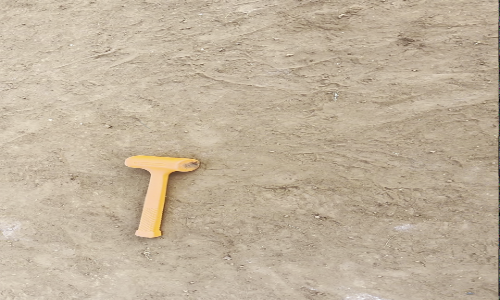

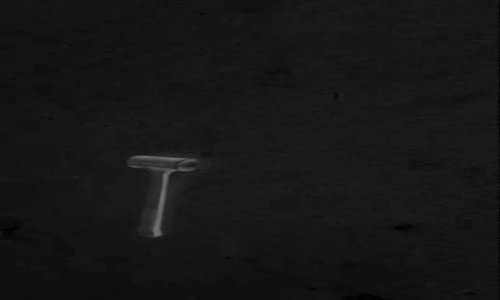

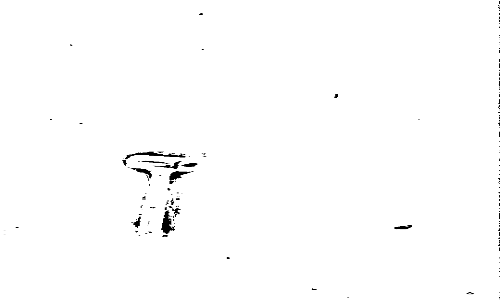

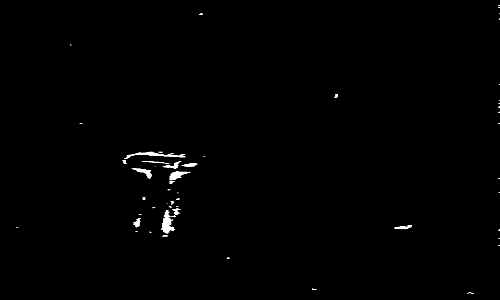

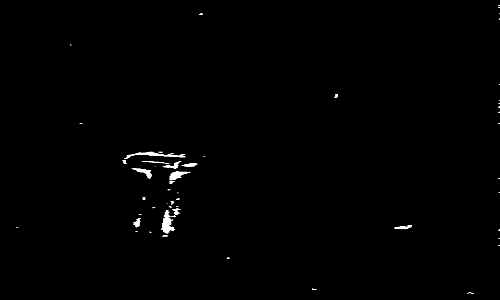

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 14.850000000000001 seconds


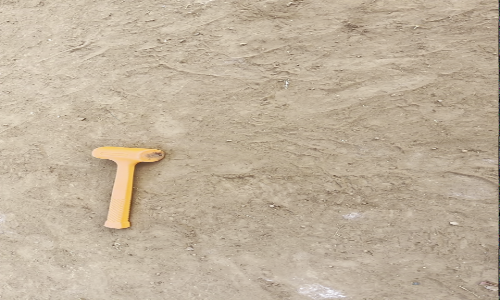

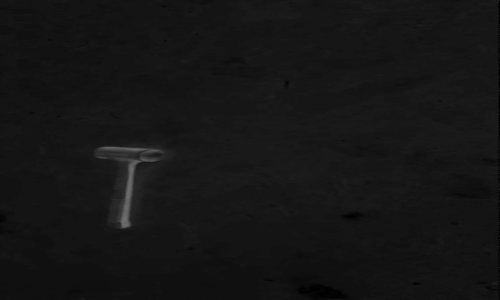

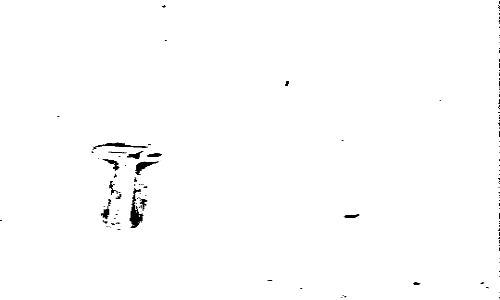

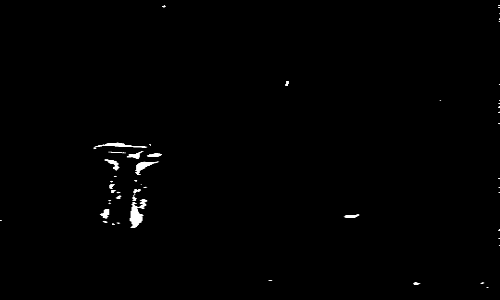

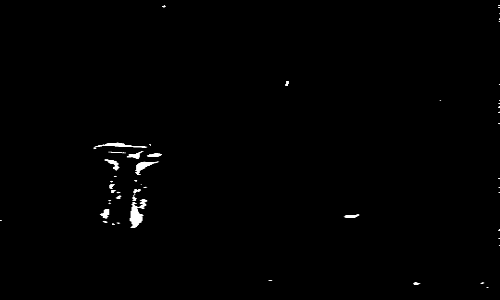

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 15.180000000000001 seconds


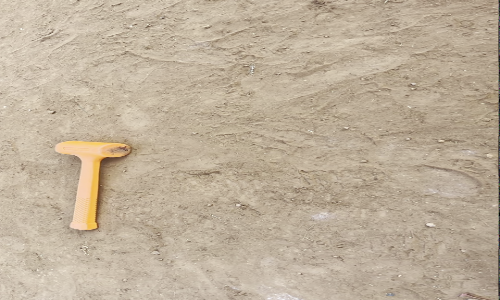

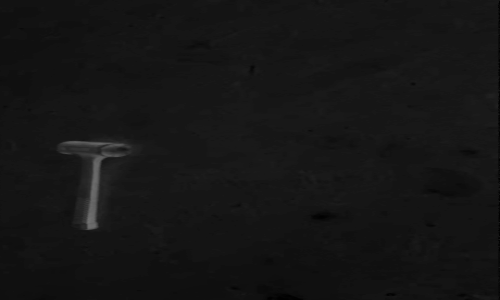

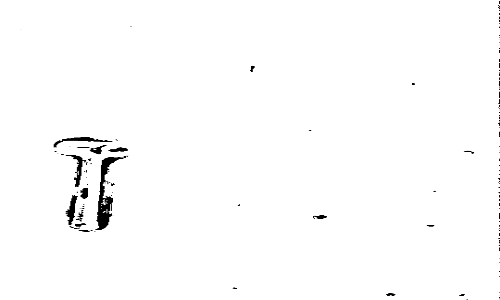

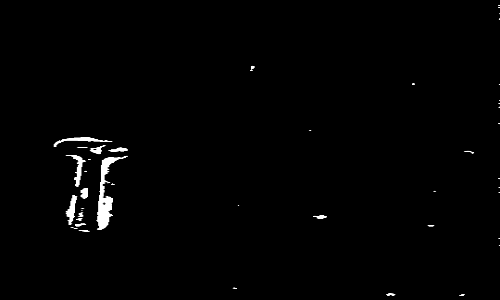

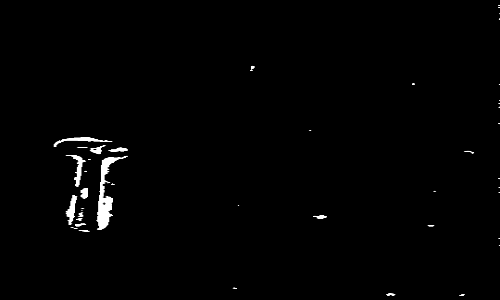

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 15.510000000000002 seconds


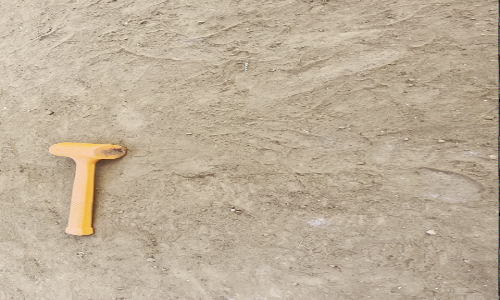

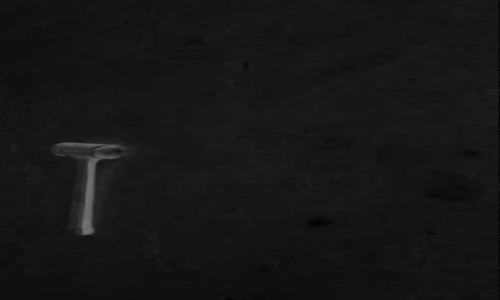

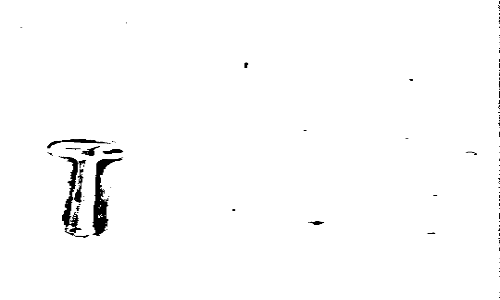

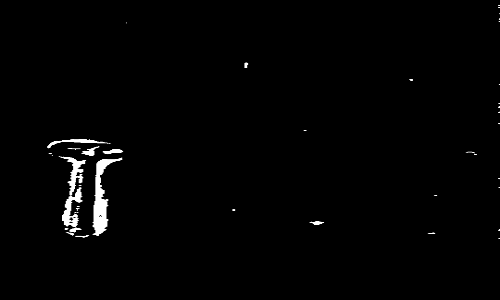

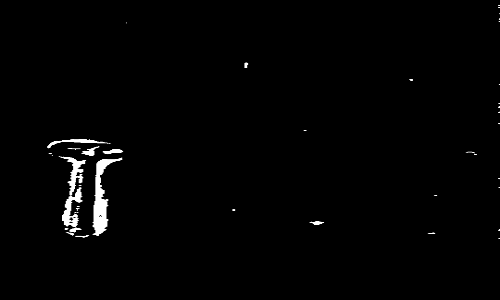

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Frame captured at 15.840000000000002 seconds


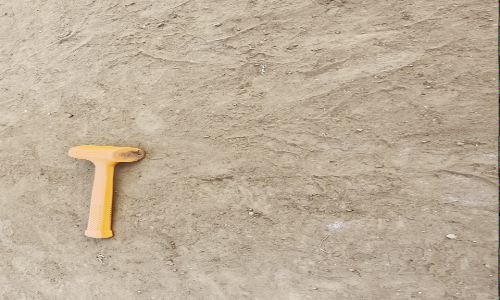

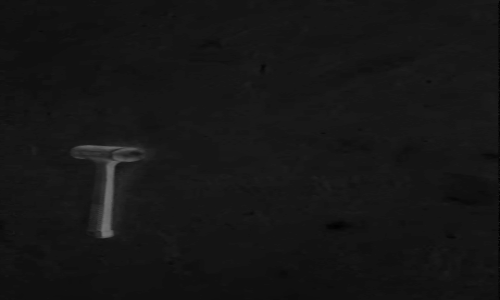

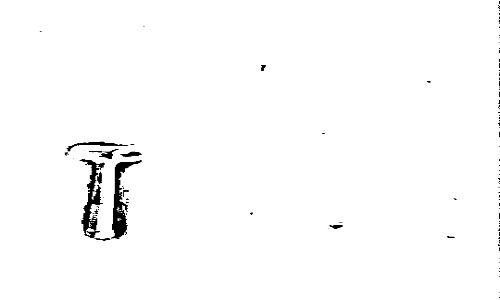

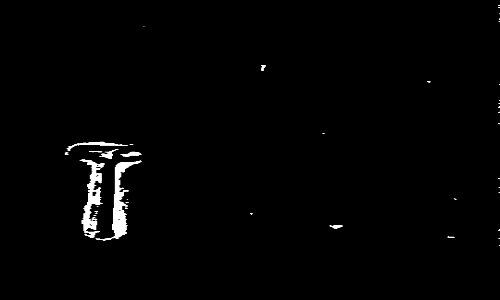

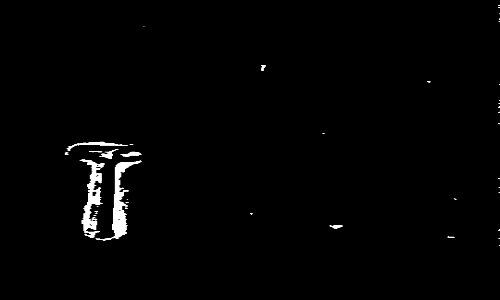

Video Info:
   FPS: 29.993738259236068
   Total frames: 479
   Duration: 15.97 seconds
Failed to capture frame at 16.17 seconds


error: OpenCV(4.12.0) /io/opencv/modules/imgproc/src/resize.cpp:4208: error: (-215:Assertion failed) !ssize.empty() in function 'resize'


: 

In [ ]:
video_path = "Mallet_videos/IMG_9105.MOV"  # Change to your video path
cap = cv2.VideoCapture(video_path)
fps = cap.get(cv2.CAP_PROP_FPS)
size = (int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)), int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)))
time_Sec = 0
while cap.isOpened():
    
    frame = capture_frame(video_path, time_Sec)
    frame = cv2.resize(frame, (size[0]//2, size[1]//2))
    if frame is not None:
        display_image(frame)    
        
    gray = preprocess_image(frame)
    gray = thresholding(gray)
    gray = refinement(gray)
    
    cv2.imshow("output", gray)
    cv2.waitKey(3)
    time_Sec += 0.33
cap.release()
cv2.destroyAllWindows()